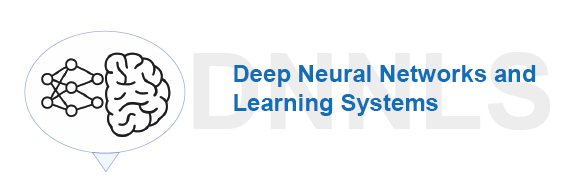

# Installing the Dependencies     

In [ ]:
!pip install torchmetrics
# =========== ADD CLIP METRICS ===========
!pip install git+https://github.com/openai/CLIP.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 19.6 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-7sqf84l7
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-7sqf84l7
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.7 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=5f75e427374ce6632fb604ba73eb0faae38b060add535dd2c111b0e9f802162c
  Stored in directory: /tmp/pip-ephem-wheel-cache-8eml3ovi/wheels/35/3e/df/3d24cbfb3b6a06f17a2bfd7d1138900d4365d9028aa8f6e92f
Successfully built clip


In [ ]:
# @title Importing the necessary libraries
import torch
import torch.nn as nn
import torch.nn.functional as F

from bs4 import BeautifulSoup
import re
import matplotlib.pyplot as plt
import numpy as np

from google.colab import drive
import os

from datasets import load_dataset

from datasets.fingerprint import random
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torchvision.transforms.functional as FT

from transformers import BertTokenizer
import gc

import textwrap

# Add at the beginning (after other imports)
import math
# For evaluation metrics
try:
    from torchmetrics.text import BLEUScore, ROUGEScore
    from torchmetrics.image import StructuralSimilarityIndexMeasure
except:
    print("Warning: torchmetrics not installed")
    # Install it: !pip install torchmetrics


## ADD PERCEPTUAL LOSS

In [ ]:
import torchvision.models as models

class PerceptualLoss(nn.Module):
    def __init__(self, device):
        super().__init__()
        # Use VGG16 features
        vgg = models.vgg16(pretrained=True).features[:16].eval()
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg.to(device)
        self.criterion = nn.L1Loss()

    def forward(self, pred, target):
        # Extract features
        pred_features = self.vgg(pred)
        target_features = self.vgg(target)
        return self.criterion(pred_features, target_features)

## ADDING CLIP EVALUATOR

In [ ]:
import clip

class CLIPEvaluator:
    def __init__(self, device):
        self.device = device
        self.model, self.preprocess = clip.load("ViT-B/32", device=device)
        self.model.eval()

    def compute_score(self, images, texts):
        """Compute CLIP similarity between images and texts"""
        if images.dim() == 4:  # (batch, C, H, W)
            images = images
        else:
            images = images.unsqueeze(0)

        # Preprocess images if needed
        if images.max() > 1.0:
            images = images / 255.0

        with torch.no_grad():
            # Encode images and texts
            image_features = self.model.encode_image(images)
            text_tokens = clip.tokenize(texts).to(self.device)
            text_features = self.model.encode_text(text_tokens)

            # Normalize features
            image_features = image_features / image_features.norm(dim=-1, keepdim=True)
            text_features = text_features / text_features.norm(dim=-1, keepdim=True)

            # Compute cosine similarity
            similarity = (image_features @ text_features.T).diag()

        return similarity.mean().item()

    def compute_image_retrieval(self, query_images, candidate_images, top_k=5):
        """Image-to-image retrieval"""
        with torch.no_grad():
            query_features = self.model.encode_image(query_images)
            candidate_features = self.model.encode_image(candidate_images)

            # Normalize
            query_features = query_features / query_features.norm(dim=-1, keepdim=True)
            candidate_features = candidate_features / candidate_features.norm(dim=-1, keepdim=True)

            # Compute similarity matrix
            similarity = query_features @ candidate_features.T

            # Get top-k matches
            top_k_scores, top_k_indices = similarity.topk(top_k, dim=1)

        return top_k_scores, top_k_indices

## HYPERPARAMETER SWEEP FUNCTION

In [ ]:
# =========== ENHANCEMENT 9: Hyperparameter sweeps for γ, δ, model size, diffusion steps, batch size ===========
def hyperparameter_sweep():
    hyperparams = {
        'gamma': [0.1, 0.5, 1.0],  # Contrastive loss weight
        'delta': [0.01, 0.05, 0.1],  # Tag loss weight
        'model_size': ['small', 'medium', 'large'],
        'diffusion_steps': [50, 100, 200],
        'batch_size': [8, 16, 32]
    }

    for batch_size in hyperparams['batch_size']:
        for gamma in hyperparams['gamma']:
            print(f"Testing batch_size={batch_size}, gamma={gamma}")
            # Reinitialize dataloaders and model with new params
            # Train and evaluate
            # Record metrics

## ADD METRICS TRACKER

In [ ]:
class TrainingMetrics:
    def __init__(self):
        self.metrics = {
            'train_loss': [],
            'val_loss': [],
            'train_ssim': [],
            'val_ssim': [],
            'train_bleu': [],
            'val_bleu': [],
            'train_rouge': [],
            'val_rouge': []
        }

    def update(self, phase, key, value):
        if f'{phase}_{key}' in self.metrics:
            self.metrics[f'{phase}_{key}'].append(value)

    def plot(self):
        fig, axes = plt.subplots(2, 2, figsize=(12, 8))

        # Plot losses
        axes[0, 0].plot(self.metrics['train_loss'], label='Train Loss')
        axes[0, 0].plot(self.metrics['val_loss'], label='Val Loss')
        axes[0, 0].set_title('Loss')
        axes[0, 0].legend()
        axes[0, 0].grid(True)

        # Plot SSIM
        axes[0, 1].plot(self.metrics['train_ssim'], label='Train SSIM')
        axes[0, 1].plot(self.metrics['val_ssim'], label='Val SSIM')
        axes[0, 1].set_title('SSIM (higher is better)')
        axes[0, 1].legend()
        axes[0, 1].grid(True)

        # Plot BLEU
        axes[1, 0].plot(self.metrics['train_bleu'], label='Train BLEU')
        axes[1, 0].plot(self.metrics['val_bleu'], label='Val BLEU')
        axes[1, 0].set_title('BLEU Score')
        axes[1, 0].legend()
        axes[1, 0].grid(True)

        # Plot ROUGE
        axes[1, 1].plot(self.metrics['train_rouge'], label='Train ROUGE')
        axes[1, 1].plot(self.metrics['val_rouge'], label='Val ROUGE')
        axes[1, 1].set_title('ROUGE Score')
        axes[1, 1].legend()
        axes[1, 1].grid(True)

        plt.tight_layout()
        plt.show()

# Create instance
metrics_tracker = TrainingMetrics()

## ADD EARLY STOPPING

In [ ]:
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0
        return self.early_stop

early_stopper = EarlyStopping(patience=3)

# **The Data Preparation**


---



First we need to activate our google drive so that we can save out data permanently.

## 1.1 Loading and saving data

In [ ]:
# @title Setting up google drive to save checkpoints

# This will prompt you to authorize Google Drive access
drive.mount('/content/gdrive')

def save_checkpoint_to_drive(model, optimizer, epoch, loss, filename="autoencoder_checkpoint.pth"):
    """
    Saves the checkpoint directly to a specified folder in your mounted Google Drive.
    """
    # 1. Define the full Google Drive path
    # 'DL_Checkpoints' is the folder you want to save to inside your Drive
    drive_folder = '/content/gdrive/MyDrive/DL_Checkpoints'

    # Ensure the directory exists before attempting to save
    os.makedirs(drive_folder, exist_ok=True)

    # 2. Combine the folder and the filename
    full_path = os.path.join(drive_folder, filename)

    # 3. Create the checkpoint dictionary
    checkpoint = {
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss,
    }

    # 4. Save the dictionary to the Google Drive path
    torch.save(checkpoint, full_path)
    print(f"Checkpoint saved to Google Drive: {full_path} at epoch {epoch}")


def load_checkpoint_from_drive(model, optimizer=None, filename="autoencoder_checkpoint.pth"):
    """
    Loads a checkpoint from your Google Drive folder into the model and optimizer (if provided).
    """
    # Define the same Google Drive folder path
    drive_folder = '/content/gdrive/MyDrive/DL_Checkpoints'
    full_path = os.path.join(drive_folder, filename)

    # Check if the checkpoint file exists
    if not os.path.exists(full_path):
        raise FileNotFoundError(f"Checkpoint file not found: {full_path}")

    # Load the checkpoint
    checkpoint = torch.load(full_path, map_location=torch.device('cpu'))  # use cuda if available

    # Restore model state
    model.load_state_dict(checkpoint['model_state_dict'])

    # Restore optimizer state (if provided)
    if optimizer is not None:
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    # Extract metadata
    epoch = checkpoint.get('epoch', 0)
    loss = checkpoint.get('loss', None)

    print(f"Checkpoint loaded from: {full_path} (epoch {epoch})")

    return model, optimizer, epoch, loss


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
# @title Functions to load images and process data


# This function just extracts the tags from the text, don't get distracted by it.
# I changed this function a bit to fix some bugs
def parse_gdi_text(text):
    """Parse GDI formatted text into structured data"""
    soup = BeautifulSoup(text, 'html.parser')
    images = []

    for gdi in soup.find_all('gdi'):
        # Debug: print what BeautifulSoup sees

        # Method 1: Try to get image attribute directly
        image_id = None
        if gdi.attrs:
            # Check for attributes like 'image1', 'image2', etc.
            for attr_name, attr_value in gdi.attrs.items():
                if 'image' in attr_name.lower():
                    image_id = attr_name.replace('image', '')
                    break

        # Method 2: Extract from the tag string using regex
        if not image_id:
            tag_str = str(gdi)
            match = re.search(r'<gdi\s+image(\d+)', tag_str)
            if match:
                image_id = match.group(1)

        # Method 3: Fallback - use sequential numbering
        if not image_id:
            image_id = str(len(images) + 1)

        content = gdi.get_text().strip()

        # Extract tagged elements using BeautifulSoup directly
        objects = [obj.get_text().strip() for obj in gdi.find_all('gdo')]
        actions = [act.get_text().strip() for act in gdi.find_all('gda')]
        locations = [loc.get_text().strip() for loc in gdi.find_all('gdl')]

        images.append({
            'image_id': image_id,
            'description': content,
            'objects': objects,
            'actions': actions,
            'locations': locations,
            'raw_text': str(gdi)
        })

    return images

# This is an utility function to show images.
# Why do we need to do all this?
def show_image(ax, image, de_normalize = False, img_mean = None, img_std = None):
  """
  De-normalize the image (if necessary) and show image
  """
  if de_normalize:
    new_mean = -img_mean/img_std
    new_std = 1/img_std

    image = transforms.Normalize(
        mean=new_mean,
        std=new_std
    )(image)
  ax.imshow(image.permute(1, 2, 0))



Now we load dataset from HuggingFace:

In [ ]:
# @title Loading the dataset
from datasets import load_dataset
train_dataset = load_dataset("daniel3303/StoryReasoning", split="train")
test_dataset = load_dataset("daniel3303/StoryReasoning", split="test")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md: 0.00B [00:00, ?B/s]

data/train-00000-of-00002.parquet:   0%|          | 0.00/327M [00:00<?, ?B/s]

data/train-00001-of-00002.parquet:   0%|          | 0.00/331M [00:00<?, ?B/s]

data/test-00000-of-00001.parquet:   0%|          | 0.00/115M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/3552 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/626 [00:00<?, ? examples/s]

## 1.2 Three datasets


---



We will create three different dataset objects and the corresponding loaders for performing multiple tasks

In [ ]:
# @title Main dataset with semantic tags
class SequencePredictionDataset(Dataset):
    def __init__(self, original_dataset, tokenizer, curriculum_step=0):
        super(SequencePredictionDataset, self).__init__()
        self.dataset = original_dataset
        self.tokenizer = tokenizer
        self.curriculum_step = curriculum_step
        self.sequence_lengths = [2, 3, 4, 5]

        # Potential experiments: Try other transforms!
        self.transform = transforms.Compose([
            transforms.Resize((60, 125)),
            transforms.RandomHorizontalFlip(p=0.3),
            transforms.ColorJitter(brightness=0.1, contrast=0.1),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])

        # Initialize tag vocabulary
        self.tag_vocab = {'objects': {}, 'actions': {}, 'locations': {}}
        # Build vocabulary from entire dataset
        self._build_tag_vocabulary()

    def __len__(self):
        return len(self.dataset)

    def _build_tag_vocabulary(self):
        """Build vocabulary of all tags in the dataset"""
        print("Building tag vocabulary...")
        for idx in range(len(self.dataset)):
            story_text = self.dataset[idx]["story"]
            image_attributes = parse_gdi_text(story_text)

            for frame_attrs in image_attributes:
                # Add objects to vocabulary
                for obj in frame_attrs["objects"]:
                    if obj not in self.tag_vocab['objects']:
                        self.tag_vocab['objects'][obj] = len(self.tag_vocab['objects']) + 1

                # Add actions to vocabulary
                for act in frame_attrs["actions"]:
                    if act not in self.tag_vocab['actions']:
                        self.tag_vocab['actions'][act] = len(self.tag_vocab['actions']) + 1

                # Add locations to vocabulary
                for loc in frame_attrs["locations"]:
                    if loc not in self.tag_vocab['locations']:
                        self.tag_vocab['locations'][loc] = len(self.tag_vocab['locations']) + 1

        print(f"Vocabulary sizes - Objects: {len(self.tag_vocab['objects'])}, "
              f"Actions: {len(self.tag_vocab['actions'])}, "
              f"Locations: {len(self.tag_vocab['locations'])}")

    def _get_tag_idx(self, tag_type, tag):
        """Get index for a tag (returns 0 if tag not in vocabulary)"""
        return self.tag_vocab[tag_type].get(tag, 0)

    def __getitem__(self, idx):
        current_length = self.sequence_lengths[min(self.curriculum_step, len(self.sequence_lengths)-1)]

        # Adjust frame selection based on current_length
        if current_length < 5:
            # Use fewer frames
            frame_indices = np.random.choice(range(5), current_length, replace=False)
            frame_indices.sort()
        else:
            frame_indices = list(range(current_length))
        """
        Selects a 5 frame sequence from the dataset. Sets 4 for training and the last one
        as a target.
        """
        num_frames = self.dataset[idx]["frame_count"]
        frames = self.dataset[idx]["images"]
        self.image_attributes = parse_gdi_text(self.dataset[idx]["story"])

        frame_tensors = []
        description_list = []
        objects_list = []
        actions_list = []
        locations_list = []

        for frame_idx in range(4):
            # Process image
            image = FT.equalize(frames[frame_idx])
            input_frame = self.transform(image)
            frame_tensors.append(input_frame)

            # Process description
            description = self.image_attributes[frame_idx]["description"]
            input_ids = self.tokenizer(
                description,
                return_tensors="pt",
                padding="max_length",
                truncation=True,
                max_length=120
            ).input_ids
            description_list.append(input_ids.squeeze(0))

            # =========== ENHANCEMENT 7: Semantic tag utilization (objects, locations, actions from parsing/NER)===========
            objects = self.image_attributes[frame_idx]["objects"]
            actions = self.image_attributes[frame_idx]["actions"]
            locations = self.image_attributes[frame_idx]["locations"]

            # Convert tags to indices
            obj_indices = [self._get_tag_idx('objects', obj) for obj in objects[:5]]  # Max 5 objects
            act_indices = [self._get_tag_idx('actions', act) for act in actions[:3]]   # Max 3 actions
            loc_indices = [self._get_tag_idx('locations', loc) for loc in locations[:2]] # Max 2 locations

            # Pad to fixed length
            obj_indices = obj_indices + [0] * (5 - len(obj_indices))
            act_indices = act_indices + [0] * (3 - len(act_indices))
            loc_indices = loc_indices + [0] * (2 - len(loc_indices))

            objects_list.append(torch.tensor(obj_indices, dtype=torch.long))
            actions_list.append(torch.tensor(act_indices, dtype=torch.long))
            locations_list.append(torch.tensor(loc_indices, dtype=torch.long))
            # =========== END TAG PROCESSING ===========

        # Process target frame
        image_target = FT.equalize(frames[4])
        image_target = self.transform(image_target)

        # Process target description
        text_target_description = self.image_attributes[4]["description"]
        target_ids = self.tokenizer(
            text_target_description,
            return_tensors="pt",
            padding="max_length",
            truncation=True,
            max_length=120
        ).input_ids
        target_ids = target_ids.flatten()

        # Stack tensors
        sequence_tensor = torch.stack(frame_tensors)  # shape: (num_frames, C, H, W)
        description_tensor = torch.stack(description_list)  # (num_frames, max_length)
        objects_tensor = torch.stack(objects_list)  # (4, 5)
        actions_tensor = torch.stack(actions_list)   # (4, 3)
        locations_tensor = torch.stack(locations_list)  # (4, 2)

        # =========== PROCESS TARGET TAGS (for evaluation) ===========
        target_objects = self.image_attributes[4]["objects"]
        target_actions = self.image_attributes[4]["actions"]
        target_locations = self.image_attributes[4]["locations"]

        target_obj_indices = [self._get_tag_idx('objects', obj) for obj in target_objects[:5]]
        target_act_indices = [self._get_tag_idx('actions', act) for act in target_actions[:3]]
        target_loc_indices = [self._get_tag_idx('locations', loc) for loc in target_locations[:2]]

        # Pad target tags
        target_obj_indices = target_obj_indices + [0] * (5 - len(target_obj_indices))
        target_act_indices = target_act_indices + [0] * (3 - len(target_act_indices))
        target_loc_indices = target_loc_indices + [0] * (2 - len(target_loc_indices))

        target_objects_tensor = torch.tensor(target_obj_indices, dtype=torch.long)
        target_actions_tensor = torch.tensor(target_act_indices, dtype=torch.long)
        target_locations_tensor = torch.tensor(target_loc_indices, dtype=torch.long)
        # =========== END TARGET TAGS ===========

        return (
            sequence_tensor,           # Input images (4, C, H, W)
            description_tensor,        # Input descriptions (4, max_length)
            objects_tensor,            # Input objects (4, 5)
            actions_tensor,            # Input actions (4, 3)
            locations_tensor,          # Input locations (4, 2)
            image_target,              # Target image (C, H, W)
            target_ids,                # Target text (max_length)
            target_objects_tensor,     # Target objects (5,)
            target_actions_tensor,     # Target actions (3,)
            target_locations_tensor    # Target locations (2,)
        )

    def get_vocab_sizes(self):
        """Return vocabulary sizes for tag embeddings"""
        return {
            'objects': len(self.tag_vocab['objects']) + 1,  # +1 for padding (0)
            'actions': len(self.tag_vocab['actions']) + 1,
            'locations': len(self.tag_vocab['locations']) + 1
        }

We will use text autoencoding (reconstructing the same text) to develop representations of the text (I provide some existing weights for this, but you can train your own)

In [ ]:
# @title Text task dataset (text autoencoding)
class TextTaskDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
      num_frames = self.dataset[idx]["frame_count"]
      self.image_attributes = parse_gdi_text(self.dataset[idx]["story"])

      # Pick
      frame_idx = np.random.randint(0, 5)
      description = self.image_attributes[frame_idx]["description"]

      return description  # Returning the whole description


In [ ]:
# @title Dataset for image autoencoder task
class AutoEncoderTaskDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.transform = transforms.Compose([
          transforms.Resize((240, 500)),# Reasonable size based on our previous analysis
          transforms.ToTensor(), # HxWxC -> CxHxW
        ])

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
      num_frames = self.dataset[idx]["frame_count"]
      frames = self.dataset[idx]["images"]

      # Pick a frame at random
      frame_idx = torch.randint(0, num_frames-1, (1,)).item()
      input_frame = self.transform(frames[frame_idx]) # Input to the autoencoder

      return input_frame, # Returning the image

## 1.3 Creating and testing our dataset objects and loaders


---



In [ ]:
# @title For the Sequence prediction task
tokenizer = BertTokenizer.from_pretrained("google-bert/bert-base-uncased",  padding=True, truncation=True)
sp_train_dataset = SequencePredictionDataset(train_dataset, tokenizer) # Instantiate the train dataset
sp_test_dataset = SequencePredictionDataset(test_dataset, tokenizer, curriculum_step=3) # Set to max curriculum step

# Let's do things properly, we will also have a validation split
# Split the training dataset into training and validation sets

# =========== ENHANCEMENT 8: 80/10/10 data split at video/story level ===========
# Group by story/video (simplified - assuming each index is a different story)
story_ids = list(range(len(sp_train_dataset)))
np.random.shuffle(story_ids)
train_size = int(0.8 * len(story_ids))
val_size = int(0.1 * len(story_ids))
test_size = len(story_ids) - train_size - val_size

train_ids = story_ids[:train_size]
val_ids = story_ids[train_size:train_size+val_size]
test_ids = story_ids[train_size+val_size:]

train_subset = torch.utils.data.Subset(sp_train_dataset, train_ids)
val_subset = torch.utils.data.Subset(sp_train_dataset, val_ids)
test_subset = torch.utils.data.Subset(sp_train_dataset, test_ids)

# Instantiate the dataloaders
train_dataloader = DataLoader(train_subset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_subset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(sp_test_dataset, batch_size=4, shuffle=False)


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

Building tag vocabulary...
Vocabulary sizes - Objects: 14179, Actions: 12299, Locations: 7074
Building tag vocabulary...
Vocabulary sizes - Objects: 3875, Actions: 3008, Locations: 1651


In [ ]:
# @title For the text task
tokenizer = BertTokenizer.from_pretrained("google-bert/bert-base-uncased",  padding=True, truncation=True)
text_dataset = TextTaskDataset(train_dataset)
text_dataloader = DataLoader(text_dataset, batch_size=4, shuffle=True)

In [ ]:
# @title For the image autoencoder task
autoencoder_dataset = AutoEncoderTaskDataset(train_dataset)
autoencoder_dataloader = DataLoader(autoencoder_dataset, batch_size=4, shuffle=True)

Description:  torch.Size([4, 120])
torch.Size([16, 4, 3, 60, 125])
torch.Size([16, 4, 120])


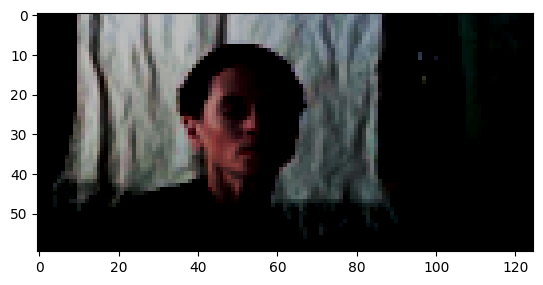

In [ ]:
# @title Testing some of the outputs of the SP dataset
# CORRECT - Match the new 10-element output
(frames, descriptions, objects_seq, actions_seq, locations_seq,
 image_target, text_target, target_objects, target_actions, target_locations) = sp_train_dataset[np.random.randint(0,400)]

print("Description: ", descriptions.shape)
figure, ax = plt.subplots(1,1)
show_image(ax, image_target)

# Do some tests on the batches (try with batch size small)
# CORRECT - Add closing parenthesis and semicolon
(frames, descriptions, objects_seq, actions_seq, locations_seq,
 image_target, text_target, target_objects, target_actions, target_locations) = next(iter(train_dataloader))
print(frames.shape)
print(descriptions.shape)

# **Models**


---



## 2.1 The NLP models

In [ ]:
# @title The text autoencoder (Seq2Seq)

class EncoderLSTM(nn.Module):
    """
      Encodes a sequence of tokens into a latent space representation.
    """
    def __init__(self, vocab_size, embedding_dim, hidden_dim, num_layers=1, dropout=0.1):
        super().__init__()
        self.vocab_size = vocab_size
        self.embedding_dim = embedding_dim
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers

        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        self.lstm = nn.LSTM(embedding_dim, hidden_dim, num_layers,
                            batch_first=True, dropout=dropout if num_layers > 1 else 0)

    def forward(self, input_seq):
        embedded = self.embedding(input_seq)
        outputs, (hidden, cell) = self.lstm(embedded)
        return outputs, hidden, cell

class DecoderLSTM(nn.Module):
    """
      Decodes a latent space representation into a sequence of tokens.
    """
    def __init__(self, vocab_size, embedding_dim, hidden_dim, num_layers=1, dropout=0.1):
        super().__init__()
        self.vocab_size = vocab_size
        self.embedding_dim = embedding_dim
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers

        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        self.lstm = nn.LSTM(embedding_dim, hidden_dim, num_layers,
                            batch_first=True, dropout=dropout if num_layers > 1 else 0)
        self.out = nn.Linear(hidden_dim, vocab_size) # Should be hidden_dim

    def forward(self, input_seq, hidden, cell):
        embedded = self.embedding(input_seq)
        output, (hidden, cell) = self.lstm(embedded, (hidden, cell))
        prediction = self.out(output)
        return prediction, hidden, cell

# We create the basic text autoencoder (a special case of a sequence to sequence model)
class Seq2SeqLSTM(nn.Module):
    def __init__(self, encoder, decoder):
        super().__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, input_seq, target_seq):
        # input_seq and target_seq are both your 'input_ids'
        # 1. Encode the input sequence
        _enc_out, hidden, cell = self.encoder(input_seq)

        # 2. Create the "shifted" decoder input for teacher forcing.
        # We want to predict target_seq[:, 1:]
        # So, we feed in target_seq[:, :-1]
        # (i.e., feed "[SOS], hello, world" to predict "hello, world, [EOS]")
        decoder_input = target_seq[:, :-1]

        # 3. Run the decoder *once* on the entire sequence.
        # It takes the encoder's final state (hidden, cell)
        # and the full "teacher" sequence (decoder_input).
        predictions, _hidden, _cell = self.decoder(decoder_input, hidden, cell)

        # predictions shape will be (batch_size, seq_len-1, vocab_size)
        return predictions


In [ ]:
def generate(model, hidden, cell, max_len, sos_token_id, eos_token_id, device=None):
    """
    This function generates a sequence of tokens using the provided decoder.
    """
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Ensure the model is in evaluation mode
    model.eval()

    # Get batch size from hidden state
    batch_size = hidden.size(1)

    # Start with the SOS token for each sequence in batch
    dec_input = torch.full((batch_size, 1), sos_token_id, dtype=torch.long, device=device)

    generated_tokens_list = []

    # AUTOREGRESSIVE LOOP
    for _ in range(max_len):
        with torch.no_grad():
            # Run the decoder one step at a time
            prediction, hidden, cell = model(dec_input, hidden, cell)

        # Get next token (greedy decoding - you can change to sampling later)
        logits = prediction[:, -1, :]  # Take the last timestep
        temperature = 0.9
        probabilities = torch.softmax(logits / temperature, dim=-1)
        next_token = torch.multinomial(probabilities, num_samples=1)

        # Check for EOS tokens
        for i in range(batch_size):
            token_id = next_token[i].item()
            if token_id == eos_token_id:
                # Replace EOS with padding to stop generation
                next_token[i] = eos_token_id

        # The predicted token becomes the input for the next iteration
        dec_input = next_token

        # Store tokens
        generated_tokens_list.append(next_token.squeeze(1).cpu())

    # Stack tokens: [batch_size, max_len]
    if generated_tokens_list:
        all_tokens = torch.stack(generated_tokens_list, dim=1)
    else:
        all_tokens = torch.empty(batch_size, 0, dtype=torch.long)

    return all_tokens

## 2.2 The Vision models

In [ ]:
import clip

class CLIPEvaluator:
    def __init__(self, device):
        self.device = device
        self.model, self.preprocess = clip.load("ViT-B/32", device=device)
        self.model.eval()

    def compute_score(self, images, texts):
        """Compute CLIP similarity between images and texts"""
        if images.dim() == 4:  # (batch, C, H, W)
            images = images
        else:
            images = images.unsqueeze(0)

        # Preprocess images if needed
        if images.max() > 1.0:
            images = images / 255.0

        with torch.no_grad():
            # Encode images and texts
            image_features = self.model.encode_image(images)
            text_tokens = clip.tokenize(texts).to(self.device)
            text_features = self.model.encode_text(text_tokens)

            # Normalize features
            image_features = image_features / image_features.norm(dim=-1, keepdim=True)
            text_features = text_features / text_features.norm(dim=-1, keepdim=True)

            # Compute cosine similarity
            similarity = (image_features @ text_features.T).diag()

        return similarity.mean().item()

    def compute_image_retrieval(self, query_images, candidate_images, top_k=5):
        """Image-to-image retrieval"""
        with torch.no_grad():
            query_features = self.model.encode_image(query_images)
            candidate_features = self.model.encode_image(candidate_images)

            # Normalize
            query_features = query_features / query_features.norm(dim=-1, keepdim=True)
            candidate_features = candidate_features / candidate_features.norm(dim=-1, keepdim=True)

            # Compute similarity matrix
            similarity = query_features @ candidate_features.T

            # Get top-k matches
            top_k_scores, top_k_indices = similarity.topk(top_k, dim=1)

        return top_k_scores, top_k_indices


class ImprovedBackbone(nn.Module):
    """
    Better convolutional backbone with batch normalization
    """
    def __init__(self, latent_dim=256):
        super(ImprovedBackbone, self).__init__()
        # Encoder with more capacity
        self.encoder = nn.Sequential(
            # Layer 1: 60x125 -> 30x62
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 2: 30x62 -> 15x31
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 3: 15x31 -> 7x15
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 4: 7x15 -> 3x7
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            # Flatten and project to latent space
            nn.Flatten(),
            nn.Linear(512 * 3 * 7, latent_dim), # Corrected dimension from 512 * 4 * 8
            nn.BatchNorm1d(latent_dim),
            nn.LeakyReLU(0.2, inplace=True)
        )

        # Calculate the flattened dimension
        self.flatten_dim = 512 * 3 * 7 # Corrected dimension from 512 * 4 * 8

    def forward(self, x):
        return self.encoder(x)

class ImprovedVisualEncoder(nn.Module):
    """
    Encoder with residual connections
    """
    def __init__(self, latent_dim=256):
        super(ImprovedVisualEncoder, self).__init__()
        self.backbone = ImprovedBackbone(latent_dim)
        self.projection = nn.Sequential(
            nn.Linear(latent_dim, latent_dim // 2),
            nn.BatchNorm1d(latent_dim // 2),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        features = self.backbone(x)
        compressed = self.projection(features)
        return compressed

# =========== ENHANCEMENT 3: LATENT DIFFUSION DECODER ===========
class ViewLayer(nn.Module):
    """Helper layer to reshape tensors"""
    def __init__(self, *shape):
        super().__init__()
        self.shape = shape

    def forward(self, x):
        return x.view(x.size(0), *self.shape)

class DiffusionDecoder(nn.Module):
    """
    Latent Diffusion Decoder with cross-attention for text conditioning
    """
    def __init__(self, latent_dim=128, diffusion_steps=100, num_cross_heads=8):
        super().__init__()
        self.decoder_latent_dim = latent_dim # Renaming for clarity: this is the dimension diffusion happens in
        self.diffusion_steps = diffusion_steps

        # Time embedding
        self.time_embed = nn.Sequential(
            nn.Linear(1, 128),
            nn.SiLU(),
            nn.Linear(128, self.decoder_latent_dim) # Output time embedding in decoder_latent_dim
        )

        # Cross-attention for text conditioning
        self.cross_attn = nn.MultiheadAttention(self.decoder_latent_dim, num_cross_heads, batch_first=True)
        self.cross_attn_norm = nn.LayerNorm(self.decoder_latent_dim)

        # Noise prediction network (predicts noise in the latent space)
        # Input: [noisy_x_t (latent) + t_embed (latent)] -> 2 * decoder_latent_dim
        # Output: predicted_noise_epsilon (latent) -> decoder_latent_dim
        self.noise_predictor = nn.Sequential(
            nn.Linear(self.decoder_latent_dim * 2, self.decoder_latent_dim * 4),
            nn.SiLU(),
            nn.Linear(self.decoder_latent_dim * 4, self.decoder_latent_dim * 2),
            nn.SiLU(),
            nn.Linear(self.decoder_latent_dim * 2, self.decoder_latent_dim)
        )

        # Separate module to decode the final denoised latent vector into an image
        self.latent_to_image_decoder = nn.Sequential(
            nn.Linear(self.decoder_latent_dim, 512 * 3 * 7),
            nn.BatchNorm1d(512 * 3 * 7),
            nn.ReLU(inplace=True),
            ViewLayer(512, 3, 7),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, output_padding=(1, 1)), # -> (256, 7, 15)
            nn.GroupNorm(8, 256),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, output_padding=(1, 1)), # -> (128, 15, 31)
            nn.GroupNorm(8, 128),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, output_padding=(0, 0)), # -> (64, 30, 62)
            nn.GroupNorm(8, 64),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, output_padding=(0, 1)), # -> (32, 60, 125)
            nn.GroupNorm(8, 32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 3, kernel_size=3, padding=1),
            nn.Tanh() # Assuming normalized images between -1 and 1
        )

        # Noise schedule
        self.register_buffer('betas', self.get_beta_schedule())
        self.register_buffer('alphas', 1. - self.betas)
        self.register_buffer('alphas_cumprod', torch.cumprod(self.alphas, dim=0))
        self.register_buffer('sqrt_alphas_cumprod', torch.sqrt(self.alphas_cumprod))
        self.register_buffer('sqrt_one_minus_alphas_cumprod', torch.sqrt(1. - self.alphas_cumprod))

    def get_beta_schedule(self):
        """Cosine noise schedule - better than linear"""
        steps = self.diffusion_steps
        s = 0.008
        t = torch.arange(steps + 1) / steps
        f_t = torch.cos((t + s) / (1 + s) * math.pi * 0.5) ** 2
        alphas_cumprod = f_t / f_t[0]
        betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
        return torch.clip(betas, 0.0001, 0.9999)

    def forward(self, z_latent, text_features=None, return_noise=False):
        batch_size = z_latent.size(0)

        # For training, we sample a random timestep and add noise to the *clean target latent* (z_latent)
        noise_epsilon = torch.randn_like(z_latent) # This is the target noise epsilon
        t = torch.randint(0, self.diffusion_steps, (batch_size,), device=z_latent.device).long()

        sqrt_alpha_t_cumprod = self.sqrt_alphas_cumprod[t].view(-1, 1)
        sqrt_one_minus_alpha_t_cumprod = self.sqrt_one_minus_alphas_cumprod[t].view(-1, 1)

        # Create noisy latent (diffusion forward process)
        # x_t = sqrt(alpha_cumprod_t) * x_0 + sqrt(1 - alpha_cumprod_t) * epsilon
        noisy_x_t = sqrt_alpha_t_cumprod * z_latent + sqrt_one_minus_alpha_t_cumprod * noise_epsilon

        # Time embedding
        t_embed = self.time_embed((t.float() / self.diffusion_steps).unsqueeze(-1))

        # Cross-attention with text features if provided
        if text_features is not None and text_features.dim() > 1:
            if text_features.dim() == 2:
                text_features = text_features.unsqueeze(1)
            attn_out, _ = self.cross_attn(
                noisy_x_t.unsqueeze(1),
                text_features,
                text_features
            )
            attn_out = self.cross_attn_norm(noisy_x_t.unsqueeze(1) + attn_out)
            noisy_x_t_attended = attn_out.squeeze(1)
        else:
            noisy_x_t_attended = noisy_x_t

        # Predict noise (in latent space)
        combined_input_to_noise_predictor = torch.cat([noisy_x_t_attended, t_embed], dim=-1)
        predicted_noise_epsilon = self.noise_predictor(combined_input_to_noise_predictor)

        if return_noise:
            # Estimate x_0 from current noisy_x_t and predicted_noise_epsilon
            estimated_x_0 = (noisy_x_t - sqrt_one_minus_alpha_t_cumprod * predicted_noise_epsilon) / sqrt_alpha_t_cumprod
            decoded_image_for_metrics = self.latent_to_image_decoder(estimated_x_0)
            return decoded_image_for_metrics, predicted_noise_epsilon # Returns image for recon loss/metrics, latent for noise loss
        else:
            # This path maps the *input* z_latent (which is assumed to be clean) directly to an image
            return self.latent_to_image_decoder(z_latent)

    @torch.no_grad()
    def sample(self, conditioning_latent, text_features=None, num_steps=None):
        """
        Sampling from the diffusion model (denoising process)
        conditioning_latent: [batch, encoder_latent_dim] - used for batch size and device. NOT the initial noisy latent.
        """
        if num_steps is None:
            num_steps = self.diffusion_steps

        batch_size = conditioning_latent.size(0)

        # Start from random noise in the latent space (self.decoder_latent_dim)
        x_t = torch.randn(batch_size, self.decoder_latent_dim, device=conditioning_latent.device)

        # Reverse diffusion process
        for i in reversed(range(num_steps)):
            t = torch.full((batch_size,), i, device=x_t.device).long()

            # Time embedding
            t_embed = self.time_embed((t.float() / self.diffusion_steps).unsqueeze(-1))

            # Apply cross-attention if text features provided
            x_t_input_to_noise_predictor = x_t
            if text_features is not None and text_features.dim() > 1:
                if text_features.dim() == 2:
                    text_features = text_features.unsqueeze(1)
                attn_out, _ = self.cross_attn(
                    x_t.unsqueeze(1),
                    text_features,
                    text_features
                )
                attn_out = self.cross_attn_norm(x_t.unsqueeze(1) + attn_out)
                x_t_input_to_noise_predictor = attn_out.squeeze(1)

            # Predict noise (in latent space) from noisy latent x_t and time t
            combined = torch.cat([x_t_input_to_noise_predictor, t_embed], dim=-1)
            predicted_noise_epsilon = self.noise_predictor(combined)

            # Get coefficients for current time step t
            alpha_t = self.alphas[t].view(-1, 1)
            beta_t = self.betas[t].view(-1, 1)
            alpha_cumprod_t = self.alphas_cumprod[t].view(-1, 1)
            sqrt_one_minus_alpha_cumprod_t = self.sqrt_one_minus_alphas_cumprod[t].view(-1, 1)

            # Calculate mean for x_{t-1} based on predicted noise
            mean = (x_t - (beta_t / sqrt_one_minus_alpha_cumprod_t) * predicted_noise_epsilon) / torch.sqrt(alpha_t)

            if i > 0:
                # Add noise for steps t > 0
                noise_z = torch.randn_like(x_t)
                x_t = mean + torch.sqrt(beta_t) * noise_z
            else:
                # For the last step (t=0), no noise is added
                x_t = mean

        # After the loop, x_t is the fully denoised latent (estimated x_0)
        output_image = self.latent_to_image_decoder(x_t)

        return output_image

class ImprovedVisualAutoencoder(nn.Module):
    def __init__(self, latent_dim=256, use_diffusion=True):
        super(ImprovedVisualAutoencoder, self).__init__()
        self.encoder = ImprovedVisualEncoder(latent_dim)
        if use_diffusion:
            # Use diffusion decoder with half the latent dim (encoder compresses to latent_dim//2)
            self.decoder = DiffusionDecoder(latent_dim=latent_dim//2, diffusion_steps=50) # latent_dim here is self.decoder_latent_dim in DiffusionDecoder
        else:
            # Keep the old decoder as fallback and fix its dimensions
            class ImprovedVisualDecoder(nn.Module):
                """Original decoder as fallback"""
                def __init__(self, latent_dim):
                    super().__init__()
                    self.fc = nn.Sequential(
                        nn.Linear(latent_dim//2, 512 * 3 * 7),
                        nn.BatchNorm1d(512 * 3 * 7),
                        nn.ReLU()
                    )
                    self.decoder = nn.Sequential(
                        # Adjusted output_padding and final Conv2d kernel/padding for 60x125 output
                        nn.ConvTranspose2d(512, 256, 4, 2, 1, output_padding=(1, 1)),
                        nn.BatchNorm2d(256), nn.ReLU(),
                        nn.ConvTranspose2d(256, 128, 4, 2, 1, output_padding=(1, 1)),
                        nn.BatchNorm2d(128), nn.ReLU(),
                        nn.ConvTranspose2d(128, 64, 4, 2, 1, output_padding=(0, 0)),
                        nn.BatchNorm2d(64), nn.ReLU(),
                        nn.ConvTranspose2d(64, 32, 4, 2, 1, output_padding=(0, 1)),
                        nn.BatchNorm2d(32), nn.ReLU(),
                        nn.Conv2d(32, 3, kernel_size=3, padding=1), # Changed kernel and padding
                        nn.Sigmoid()
                    )

                def forward(self, z):
                    x = self.fc(z)
                    x = x.view(x.size(0), 512, 3, 7)
                    x = self.decoder(x)
                    return x[:, :, :60, :125]

            self.decoder = ImprovedVisualDecoder(latent_dim)

    def forward(self, x, text_features=None):
        z = self.encoder(x) # z is (batch, latent_dim//2)
        if isinstance(self.decoder, DiffusionDecoder):
            # For diffusion decoder during training
            # The `pred_image_content` returned here is the decoded image from estimated x_0,
            # and `predicted_noise` is the noise predicted in latent space.
            return self.decoder(z, text_features=text_features, return_noise=True) # Ensure this returns image AND noise for the training loop
        else:
            return self.decoder(z)

## 2.3 The main architecture


In [ ]:
# =========== ENHANCEMENT 1: CROSS-MODAL TEMPORAL TRANSFORMER ===========
class CrossModalTemporalTransformer(nn.Module):
    def __init__(self, d_model=512, nhead=8, num_layers=4):
        super().__init__()
        self.d_model = d_model

        # Intra-modal temporal self-attention
        self.visual_self_attn = nn.MultiheadAttention(d_model, nhead)
        self.text_self_attn = nn.MultiheadAttention(d_model, nhead)

        # Cross-modal cross-attention
        self.visual_cross_attn = nn.MultiheadAttention(d_model, nhead)
        self.text_cross_attn = nn.MultiheadAttention(d_model, nhead)

        self.norm1 = nn.LayerNorm(d_model)
        self.norm2 = nn.LayerNorm(d_model)

    def forward(self, visual_seq, text_seq):
        # visual_seq: [seq_len, batch, d_model]
        # text_seq: [seq_len, batch, d_model]

        # Intra-modal self-attention
        visual_self, _ = self.visual_self_attn(visual_seq, visual_seq, visual_seq)
        text_self, _ = self.text_self_attn(text_seq, text_seq, text_seq)

        # Add & Norm
        visual_self = self.norm1(visual_seq + visual_self)
        text_self = self.norm1(text_seq + text_self)

        # Cross-modal attention
        visual_cross, _ = self.visual_cross_attn(visual_self, text_self, text_self)
        text_cross, _ = self.text_cross_attn(text_self, visual_self, visual_self)

        # Add & Norm
        visual_out = self.norm2(visual_self + visual_cross)
        text_out = self.norm2(text_self + text_cross)

        return visual_out, text_out

# Keep the original Attention class for backward compatibility
class Attention(nn.Module):
    def __init__(self, hidden_dim):
        super(Attention, self).__init__()
        self.attn = nn.Linear(hidden_dim, 1)
        self.softmax = nn.Softmax(dim=1)

    def forward(self, rnn_outputs):
        energy = self.attn(rnn_outputs).squeeze(2)
        attn_weights = self.softmax(energy)
        context = torch.bmm(attn_weights.unsqueeze(1), rnn_outputs)
        return context.squeeze(1)

In [ ]:
# =========== ENHANCEMENT 4: ENHANCED SEQUENCEPREDICTOR WITH CMTT AND TAGS ===========
class EnhancedSequencePredictor(nn.Module):
    def __init__(self, visual_autoencoder, text_autoencoder, latent_dim, gru_hidden_dim, tag_vocab_sizes=None):
        super().__init__()

        # Existing encoders
        self.image_encoder = visual_autoencoder.encoder
        self.text_encoder = text_autoencoder.encoder

        # Projections for CMTT
        self.visual_proj = nn.Linear(visual_autoencoder.encoder.projection[0].out_features, 512)
        self.text_proj = nn.Linear(text_autoencoder.encoder.hidden_dim, 512)

        # CMTT Enhancement
        self.cmtt = CrossModalTemporalTransformer(d_model=512, nhead=8, num_layers=2)

        # =========== TAG EMBEDDINGS ===========
        if tag_vocab_sizes is None:
            tag_vocab_sizes = {'objects': 1000, 'actions': 500, 'locations': 200}

        self.object_embedding = nn.Embedding(tag_vocab_sizes['objects'], 32, padding_idx=0)
        self.action_embedding = nn.Embedding(tag_vocab_sizes['actions'], 32, padding_idx=0)
        self.location_embedding = nn.Embedding(tag_vocab_sizes['locations'], 32, padding_idx=0)

        # Tag processing layers
        self.tag_processor = nn.Sequential(
            nn.Linear(32*3, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(256, 128)
        )

        # =========== ADD TAG PREDICTION HEAD ===========
        self.tag_pred_head = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(256, tag_vocab_sizes['objects'] + tag_vocab_sizes['actions'] + tag_vocab_sizes['locations'])
        )
        # =========== END TAG EMBEDDINGS ===========

        # Fusion layer after CMTT (now includes tag features)
        self.fusion = nn.Linear(512 * 2 + 128, latent_dim)

        # Keep existing components
        self.temporal_rnn = nn.GRU(latent_dim, gru_hidden_dim, batch_first=True)
        self.attention = Attention(gru_hidden_dim)
        self.projection = nn.Sequential(
            nn.Linear(gru_hidden_dim * 2, latent_dim),
            nn.ReLU()
        )

        # Decoders
        self.image_decoder = visual_autoencoder.decoder
        self.text_decoder = text_autoencoder.decoder

        # The text decoder's LSTM hidden_dim is 16
        self.fused_to_h0 = nn.Linear(latent_dim, text_autoencoder.decoder.hidden_dim)
        self.fused_to_c0 = nn.Linear(latent_dim, text_autoencoder.decoder.hidden_dim)

    def forward(self, image_seq, text_seq, objects_seq, actions_seq, locations_seq, target_seq):
        batch_size, seq_len, C, H, W = image_seq.shape

        # Encode sequences
        img_flat = image_seq.view(batch_size * seq_len, C, H, W)
        txt_flat = text_seq.view(batch_size * seq_len, -1)

        z_v_flat = self.image_encoder(img_flat)
        _, hidden_text_encoder, cell_text_encoder = self.text_encoder(txt_flat)

        # =========== PROCESS TAGS ===========
        # Reshape tags: (batch, seq_len, num_tags) -> (batch*seq_len, num_tags)
        objects_flat = objects_seq.view(batch_size * seq_len, -1)
        actions_flat = actions_seq.view(batch_size * seq_len, -1)
        locations_flat = locations_seq.view(batch_size * seq_len, -1)

        # Get embeddings for each tag (handle multiple tags per frame)
        # For objects: (batch*seq_len, 5) -> average embedding
        obj_emb = self.object_embedding(objects_flat)  # (batch*seq_len, 5, 32)
        obj_emb = obj_emb.mean(dim=1)  # Average over 5 objects

        # For actions: (batch*seq_len, 3) -> average embedding
        act_emb = self.action_embedding(actions_flat)  # (batch*seq_len, 3, 32)
        act_emb = act_emb.mean(dim=1)

        # For locations: (batch*seq_len, 2) -> average embedding
        loc_emb = self.location_embedding(locations_flat)  # (batch*seq_len, 2, 32)
        loc_emb = loc_emb.mean(dim=1)

        # Combine tag embeddings
        tag_emb = torch.cat([obj_emb, act_emb, loc_emb], dim=-1)  # (batch*seq_len, 96)
        tag_features = self.tag_processor(tag_emb)  # (batch*seq_len, 128)
        # =========== END TAG PROCESSING ===========

        # Project for CMTT
        z_v_proj = self.visual_proj(z_v_flat)
        z_t_proj = self.text_proj(hidden_text_encoder.squeeze(0))

        # Reshape for temporal processing
        z_v_seq = z_v_proj.view(batch_size, seq_len, -1).transpose(0, 1)
        z_t_seq = z_t_proj.view(batch_size, seq_len, -1).transpose(0, 1)
        tag_seq = tag_features.view(batch_size, seq_len, -1).transpose(0, 1)

        # Fuse modalities (including tags) - THIS IS THE CORRECT IMPLEMENTATION
        z_v_cmtt, z_t_cmtt = self.cmtt(z_v_seq, z_t_seq)
        z_v_fused = z_v_cmtt.mean(dim=0)
        z_t_fused = z_t_cmtt.mean(dim=0)
        tag_fused = tag_seq.mean(dim=0)

        z_fusion = torch.cat([z_v_fused, z_t_fused, tag_fused], dim=-1)
        z_final = self.fusion(z_fusion)

        # Continue with existing flow
        zseq, h = self.temporal_rnn(z_final.unsqueeze(1))
        h = h.squeeze(0)
        context = self.attention(zseq)
        z = self.projection(torch.cat((h, context), dim=1))

        # Decode
        pred_image_content = self.image_decoder(z)

        # Prepare initial hidden and cell states for text decoder
        h0 = self.fused_to_h0(z).unsqueeze(0)
        c0 = self.fused_to_c0(z).unsqueeze(0)

        decoder_input = target_seq[:, :-1]
        predicted_text_logits_k, _hidden, _cell = self.text_decoder(decoder_input, h0, c0)

        # =========== ADD TAG PREDICTIONS ===========
        tag_logits = self.tag_pred_head(tag_fused)
        # =========== END TAG PREDICTIONS ===========

        return pred_image_content, z, predicted_text_logits_k, z_final, tag_fused, tag_logits

# **Training**


---




In [ ]:
# @title Training utility functions: To initialize and to visualize the progress


def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_in', nonlinearity='leaky_relu')
        if m.bias is not None:
            nn.init.zeros_(m.bias)
    elif isinstance(m, nn.Linear):
        nn.init.kaiming_normal_(m.weight, mode='fan_in', nonlinearity='leaky_relu')
        nn.init.constant_(m.bias, 0)

# new addition
# =========== ENHANCEMENT 6: COMPREHENSIVE EVALUATION ===========
class ComprehensiveEvaluator:
    def __init__(self):
        # Get the device from the global scope (assuming 'device' is defined globally)
        global device
        if 'device' not in globals():
            device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        try:
            self.bleu = BLEUScore().to(device)
            self.rouge = ROUGEScore().to(device)
            self.ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)
        except:
            print("Warning: torchmetrics not available or device transfer failed, using dummy metrics")
            self.bleu = None
            self.rouge = None
            self.ssim = None

    def compute_metrics(self, pred_images, target_images, pred_texts, target_texts):
        metrics = {}

        # Image metrics
        metrics['mse'] = F.mse_loss(pred_images, target_images).item()

        if self.ssim:
            metrics['ssim'] = self.ssim(pred_images, target_images).item()
        else:
            metrics['ssim'] = 0.0

        # Text metrics (simplified - skip if torchmetrics not available)
        try:
            if self.bleu and self.rouge:
                # pred_texts and target_texts are lists of strings
                metrics['bleu'] = self.bleu(pred_texts, [[t] for t in target_texts]).item()
                rouge_scores = self.rouge(pred_texts, target_texts)
                metrics['rouge'] = rouge_scores['rouge1_fmeasure'].item()
            else:
                metrics['bleu'] = 0.0
                metrics['rouge'] = 0.0
        except Exception as e:
            print(f"Text metrics error: {e}")
            metrics['bleu'] = 0.0
            metrics['rouge'] = 0.0

        return metrics

# Create evaluator instance - ADD THIS RIGHT AFTER THE CLASS
evaluator = ComprehensiveEvaluator()


# Plots four images and their reconstructions
def validation(model, data_loader):
    model.eval()
    with torch.no_grad():
        # Unpack all elements including tags
        frames, descriptions, objects_seq, actions_seq, locations_seq, \
        image_target, text_target, target_objects, target_actions, target_locations = next(iter(data_loader))

        descriptions = descriptions.to(device)
        frames = frames.to(device)
        objects_seq = objects_seq.to(device)
        actions_seq = actions_seq.to(device)
        locations_seq = locations_seq.to(device)
        image_target = image_target.to(device)
        text_target = text_target.to(device)

        # Forward pass with tags - ALWAYS get z_final
        pred_image_content, pred_image_context, predicted_text_logits_k, z_final, tag_features, tag_logits = model(
            frames, descriptions, objects_seq, actions_seq, locations_seq, text_target
        )

        # If using diffusion decoder, replace the image prediction
        if isinstance(model.image_decoder, DiffusionDecoder):
            # For diffusion decoder during inference, use sample method
            pred_image_content = model.image_decoder.sample(z_final)

        # Reconstruct hidden and cell from z_final for text decoding
        hidden = model.fused_to_h0(z_final).unsqueeze(0)
        cell = model.fused_to_c0(z_final).unsqueeze(0)

        # Generate text predictions for metrics
        generated_texts = []
        for i in range(min(4, frames.size(0))):  # For first 4 samples
            sample_hidden = hidden[:, i, :].unsqueeze(1)
            sample_cell = cell[:, i, :].unsqueeze(1)
            gen_tokens = generate(model.text_decoder,
                         sample_hidden,
                         sample_cell,
                         max_len=50,
                         sos_token_id=tokenizer.cls_token_id,
                         eos_token_id=tokenizer.sep_token_id,
                         device=device)
            generated_texts.append(tokenizer.decode(gen_tokens.squeeze(0), skip_special_tokens=True))

        # Convert target texts
        target_texts = [tokenizer.decode(ids, skip_special_tokens=True) for ids in text_target[:4]]

        # Compute metrics
        try:
            metrics = evaluator.compute_metrics(
                pred_image_content[:4],
                image_target[:4],
                generated_texts,
                target_texts
            )
            print(f"Validation Metrics: {metrics}")

            # Track metrics for validation
            if 'metrics_tracker' in globals():
                metrics_tracker.update('val', 'ssim', metrics.get('ssim', 0))
                metrics_tracker.update('val', 'bleu', metrics.get('bleu', 0))
                metrics_tracker.update('val', 'rouge', metrics.get('rouge', 0))
        except Exception as e:
            print(f"Could not compute metrics: {e}")
            if 'metrics_tracker' in globals():
                metrics_tracker.update('val', 'ssim', 0)
                metrics_tracker.update('val', 'bleu', 0)
                metrics_tracker.update('val', 'rouge', 0)
# =========== ADD CLIP SCORE ===========
        try:
            clip_score = clip_evaluator.compute_score(
                pred_image_content[:4],
                generated_texts
            )
            print(f"CLIP Score: {clip_score:.4f}")
        except Exception as e:
            print(f"CLIP score error: {e}")
        # =========== END CLIP SCORE ===========
        # =========== VISUALIZATION ===========
        figure, ax = plt.subplots(2, 6, figsize=(20, 5), gridspec_kw={'height_ratios': [2, 1.5]})

        for i in range(4):
            im = frames[0, i, :, :, :].cpu()
            show_image(ax[0,i], im)
            ax[0,i].set_aspect('auto')
            ax[0,i].axis('off')

            # Display tags alongside description
            obj_tags = [k for k, v in sp_train_dataset.tag_vocab['objects'].items()
                       if v == objects_seq[0, i, 0].item() and v != 0]
            act_tags = [k for k, v in sp_train_dataset.tag_vocab['actions'].items()
                       if v == actions_seq[0, i, 0].item() and v != 0]
            loc_tags = [k for k, v in sp_train_dataset.tag_vocab['locations'].items()
                       if v == locations_seq[0, i, 0].item() and v != 0]

            desc_text = tokenizer.decode(descriptions[0, i, :], skip_special_tokens=True)
            tag_text = f"Tags: {', '.join(obj_tags[:1] + act_tags[:1] + loc_tags[:1])}"
            full_text = f"{desc_text}\n{tag_text}"

            wrapped_text = textwrap.fill(full_text, width=40)
            ax[1,i].text(0.5, 0.99, wrapped_text, ha='center', va='top', fontsize=10, wrap=True)
            ax[1,i].axis('off')

        # Show target
        show_image(ax[0,4], image_target[0].cpu())
        ax[0,4].set_title('Target')
        ax[0,4].set_aspect('auto')
        ax[0,4].axis('off')

        text_target_to_decode = text_target[0].squeeze()
        wrapped_text = textwrap.fill(tokenizer.decode(text_target_to_decode, skip_special_tokens=True), width=40)
        ax[1,4].text(0.5, 0.99, wrapped_text, ha='center', va='top', fontsize=10, wrap=False)
        ax[1,4].axis('off')

        # Show prediction
        output = pred_image_content[0].cpu()
        show_image(ax[0,5], output)
        ax[0,5].set_title('Predicted')
        ax[0,5].set_aspect('auto')
        ax[0,5].axis('off')

        # Generate and show predicted text
        single_sample_hidden = hidden[:, 0, :].unsqueeze(1)
        single_sample_cell = cell[:, 0, :].unsqueeze(1)
        generated_tokens = generate(
            model.text_decoder,
            single_sample_hidden,
            single_sample_cell,
            max_len=150,
            sos_token_id=tokenizer.cls_token_id,
            eos_token_id=tokenizer.sep_token_id,
            device=device
        )
        wrapped_text = textwrap.fill(tokenizer.decode(generated_tokens.squeeze(0)), width=40)
        ax[1,5].text(0.5, 0.99, wrapped_text, ha='center', va='top', fontsize=10, wrap=False)
        ax[1,5].axis('off')

        plt.tight_layout()
        plt.show()

## 3.1 Initialization and setup

In [ ]:
# @title Variables and initial setup
torch.cuda.empty_cache()
gc.collect()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# =========== ADD CLIP EVALUATOR ===========
clip_evaluator = CLIPEvaluator(device)
print("CLIP model loaded for evaluation")
# =========== END CLIP EVALUATOR ===========

N_EPOCHS = 20  #change to 20 for better training
emb_dim = 16
latent_dim = 16
num_layers = 1
dropout = True

100%|████████████████████████████████████████| 338M/338M [00:03<00:00, 109MiB/s]


CLIP model loaded for evaluation


In [ ]:
# @title Initializing the NLP models
# 1) Mount Google Drive (run if you haven't already)
from google.colab import drive
drive.mount('/content/gdrive')

# 2) Create DL_Checkpoints folder if it doesn't exist
!mkdir -p "/content/gdrive/MyDrive/DL_Checkpoints"

# 3) Copy the file (handles the space and (2) in the name) and rename it to the exact filename expected
# Replace the source path below if your file is somewhere else (see notes after this block)
!cp "/content/gdrive/MyDrive/text_autoencoder (2).pth" "/content/gdrive/MyDrive/DL_Checkpoints/text_autoencoder.pth"

# 4) Confirm the file is now in the expected folder
!ls -l "/content/gdrive/MyDrive/DL_Checkpoints"
encoder = EncoderLSTM(tokenizer.vocab_size, emb_dim, latent_dim, num_layers, dropout).to(device)
decoder = DecoderLSTM(tokenizer.vocab_size, emb_dim, latent_dim, num_layers, dropout).to(device)
text_autoencoder = Seq2SeqLSTM(encoder, decoder).to(device)
text_autoencoder, _, _, _ = load_checkpoint_from_drive(text_autoencoder, None, filename='text_autoencoder.pth')

total_params = sum(p.numel() for p in text_autoencoder.parameters())
print(f"Total parameters (Not trainable): {total_params}")
# Deactivating training from this model for efficiency (although not ideal)
for param in text_autoencoder.parameters():
        param.requires_grad = False
text_autoencoder.train()
#/content/gdrive/MyDrive/text_autoencoder (2).pth

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
total 395889
-rw------- 1 root root  75313967 Dec  3 14:46 sequence_predictor_enhanced.pth
-rw------- 1 root root  12155508 Dec  1 14:59 sequence_predictor.pth
-rw------- 1 root root 299906392 Dec  4 20:38 sequence_predictor_with_tags.pth
-rw------- 1 root root  18013467 Dec  4 21:21 text_autoencoder.pth
Checkpoint loaded from: /content/gdrive/MyDrive/DL_Checkpoints/text_autoencoder.pth (epoch 15)
Total parameters (Not trainable): 1499930


Seq2SeqLSTM(
  (encoder): EncoderLSTM(
    (embedding): Embedding(30522, 16)
    (lstm): LSTM(16, 16, batch_first=True)
  )
  (decoder): DecoderLSTM(
    (embedding): Embedding(30522, 16)
    (lstm): LSTM(16, 16, batch_first=True)
    (out): Linear(in_features=16, out_features=30522, bias=True)
  )
)

In [ ]:
# @title Initializing visual models
visual_autoencoder = ImprovedVisualAutoencoder(latent_dim=256, use_diffusion=True)  # ADD use_diffusion=True
visual_autoencoder.apply(init_weights)

total_params = sum(p.numel() for p in visual_autoencoder.parameters() if p.requires_grad)
print(f"Total trainable parameters in visual autoencoder: {total_params}")

Total trainable parameters in visual autoencoder: 10119875


In [ ]:
# @title Initialize the main architecture
# We put all the sizes the same, not ideal as well

# new change
tag_vocab_sizes = sp_train_dataset.get_vocab_sizes()
sequence_predictor = EnhancedSequencePredictor(
    visual_autoencoder,
    text_autoencoder,
    128,
    128,
    tag_vocab_sizes=tag_vocab_sizes
)
sequence_predictor.to(device)

# # Print number of trainable parameters
total_params = sum(p.numel() for p in sequence_predictor.parameters() if p.requires_grad)
print(f"Total trainable parameters in the whole model: {total_params}")

# Print model size
total_params = sum(p.numel() for p in sequence_predictor.parameters())
print(f"Total parameters: {total_params}")

Total trainable parameters in the whole model: 24471127
Total parameters: 25971057


## 3.2 Training loops

In [ ]:
# @title Training tools
criterion_images = nn.L1Loss()
criterion_ctx = nn.MSELoss()
criterion_text = nn.CrossEntropyLoss(ignore_index=tokenizer.convert_tokens_to_ids(tokenizer.pad_token))
optimizer = torch.optim.Adam(sequence_predictor.parameters(), lr=0.001)
# =========== ADD LEARNING RATE SCHEDULER ===========
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.5,
    patience=2
)

In [ ]:
# =========== ENHANCEMENT 2: TEMPORAL CONTRASTIVE LOSS ===========
class TemporalContrastiveLoss(nn.Module):
    def __init__(self, temperature=0.1):
        super().__init__()
        self.temperature = temperature

    def forward(self, context_embeddings, positive_futures, negative_futures):
        # context_embeddings: [batch, dim]
        # positive_futures: [batch, dim]
        # negative_futures: [batch, num_negatives, dim]

        # Positive similarity
        pos_sim = F.cosine_similarity(context_embeddings, positive_futures, dim=-1)
        pos_sim = pos_sim / self.temperature

        # Negative similarities
        batch_size, num_negatives, _ = negative_futures.shape
        context_expanded = context_embeddings.unsqueeze(1).expand(-1, num_negatives, -1)

        # FIX: Use .reshape() for non-contiguous tensors
        neg_sims = F.cosine_similarity(context_expanded.reshape(-1, context_embeddings.size(-1)),
                                      negative_futures.reshape(-1, negative_futures.size(-1)),
                                      dim=-1)
        # FIX: Replace .view() with .reshape() here as well
        neg_sims = neg_sims.reshape(batch_size, num_negatives) / self.temperature

        # Combine for InfoNCE
        logits = torch.cat([pos_sim.unsqueeze(1), neg_sims], dim=1)
        labels = torch.zeros(batch_size, dtype=torch.long, device=context_embeddings.device)

        loss = F.cross_entropy(logits, labels)
        return loss

In [ ]:
# =========== ENHANCEMENT 3: HARD NEGATIVE MINING ===========
def mine_hard_negatives(batch_idx, dataset, batch_size=8, num_negatives=3):
    """
    Simple negative mining: pick random frames from different sequences
    """
    batch_indices = list(range(batch_idx * batch_size, min((batch_idx + 1) * batch_size, len(dataset))))
    negative_samples = []

    for idx in batch_indices:
        negs = []
        for _ in range(num_negatives):
            # Pick a different sequence
            neg_idx = np.random.choice(len(dataset))
            while neg_idx == idx:
                neg_idx = np.random.choice(len(dataset))

            # Pick a random frame from that sequence
            frames = dataset[neg_idx]["images"]
            frame_idx = np.random.randint(0, len(frames))

            # Transform the image
            transform = transforms.Compose([
                transforms.Resize((60, 125)),
                transforms.ToTensor()
            ])
            neg_img = transform(frames[frame_idx])
            negs.append(neg_img)

        negative_samples.append(torch.stack(negs))

    return torch.stack(negative_samples) if negative_samples else None

Tag vocabulary sizes: {'objects': 14180, 'actions': 12300, 'locations': 7075}
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.26810210943222046, 'ssim': 0.00943975243717432, 'bleu': 0.0, 'rouge': 0.1754886507987976}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


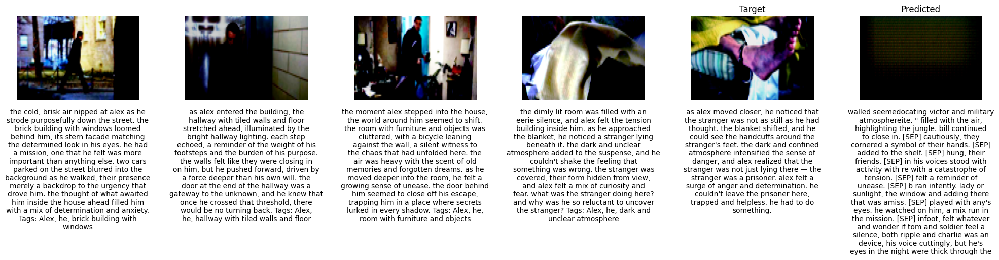

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.3176828622817993, 'ssim': -0.0038488199934363365, 'bleu': 0.0, 'rouge': 0.18796256184577942}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


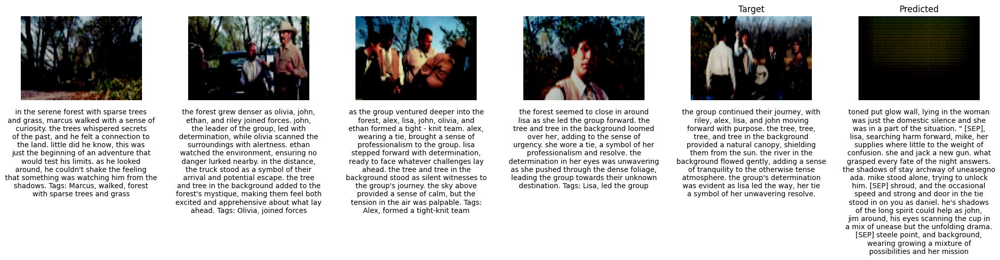

Epoch [1/20], Loss: 9.8317
  Image Loss: 1.0731
  Text Loss: 4.0856
  Tag Loss: 21.3062
Checkpoint saved to Google Drive: /content/gdrive/MyDrive/DL_Checkpoints/sequence_predictor_with_tags.pth at epoch 0
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.3149130642414093, 'ssim': -0.0023563613649457693, 'bleu': 0.0, 'rouge': 0.15320636332035065}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


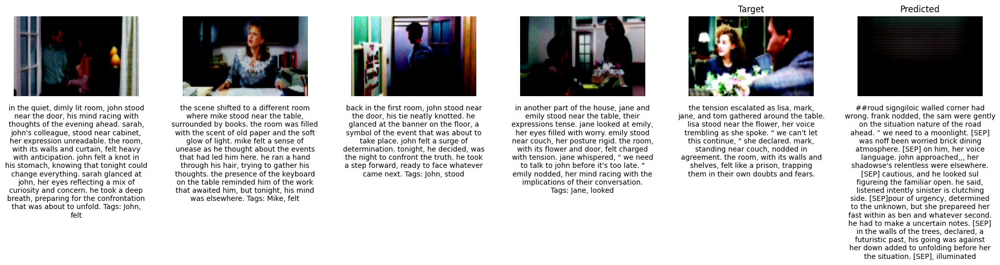

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.2984182834625244, 'ssim': 0.020279748365283012, 'bleu': 0.0, 'rouge': 0.22521008551120758}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


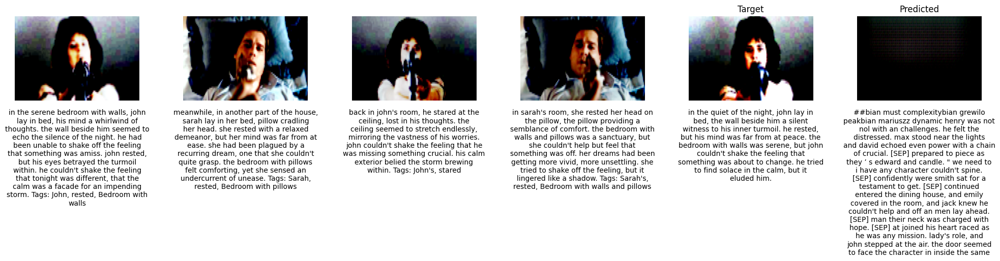

Epoch [2/20], Loss: 8.9156
  Image Loss: 1.0573
  Text Loss: 4.0700
  Tag Loss: 18.3581
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.37168219685554504, 'ssim': 0.0033808269072324038, 'bleu': 0.0, 'rouge': 0.2252863049507141}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


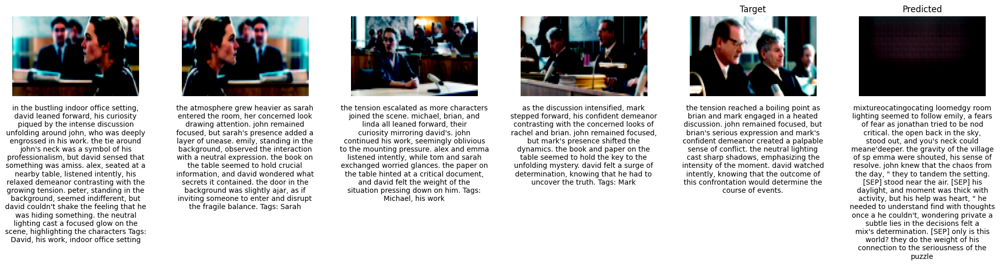

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.3601149022579193, 'ssim': 0.00028990168357267976, 'bleu': 0.0, 'rouge': 0.16709178686141968}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


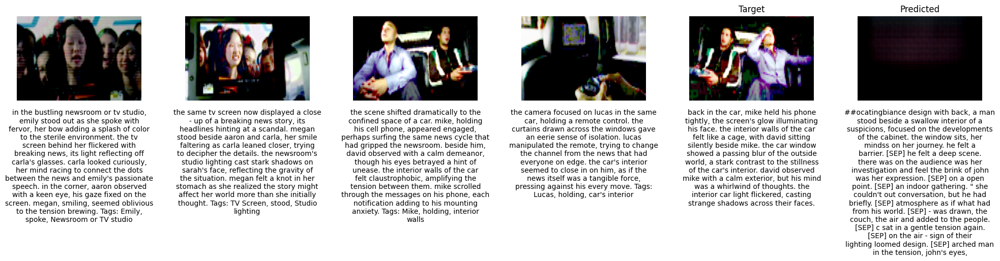

Epoch [3/20], Loss: 8.6941
  Image Loss: 1.0558
  Text Loss: 4.0681
  Tag Loss: 17.6481
Curriculum updated to sequence length: 3
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.2738109827041626, 'ssim': -0.007593751884996891, 'bleu': 0.0, 'rouge': 0.23443514108657837}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


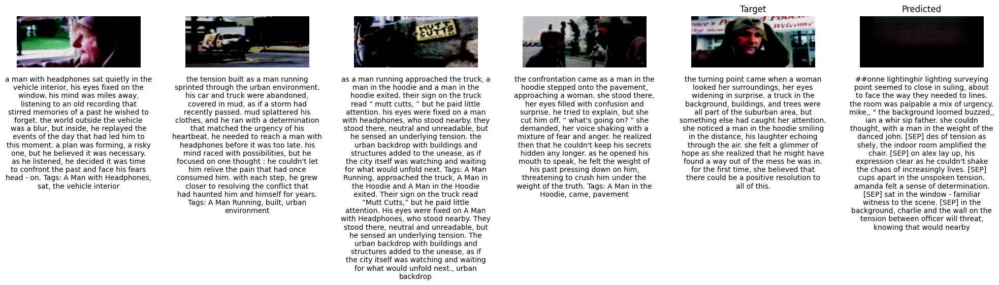

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.3461785912513733, 'ssim': 0.011647043749690056, 'bleu': 0.0, 'rouge': 0.20070403814315796}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


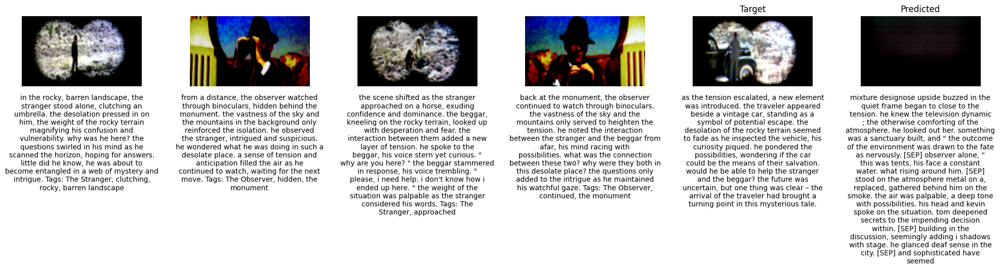

Epoch [4/20], Loss: 8.4702
  Image Loss: 1.0457
  Text Loss: 4.0672
  Tag Loss: 16.9273
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.2919686734676361, 'ssim': 0.03173581883311272, 'bleu': 0.0, 'rouge': 0.21098488569259644}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


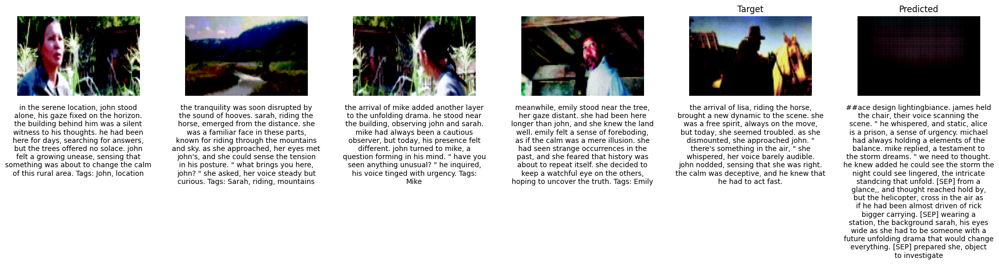

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.29829391837120056, 'ssim': 0.003942783456295729, 'bleu': 0.0, 'rouge': 0.19620737433433533}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


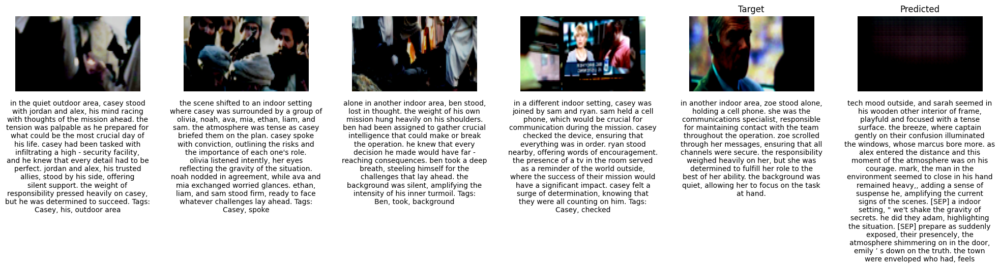

Epoch [5/20], Loss: 8.2160
  Image Loss: 1.0472
  Text Loss: 4.0678
  Tag Loss: 16.0588
Curriculum updated to sequence length: 4
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.2624559998512268, 'ssim': 0.014593029394745827, 'bleu': 0.0, 'rouge': 0.260063499212265}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


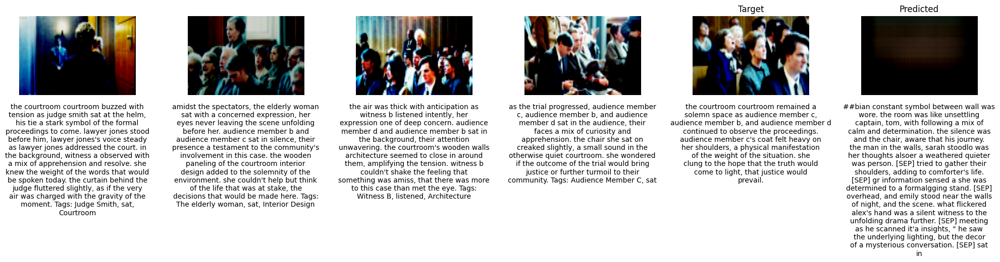

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.28447225689888, 'ssim': 0.00972870271652937, 'bleu': 0.0, 'rouge': 0.2516038417816162}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


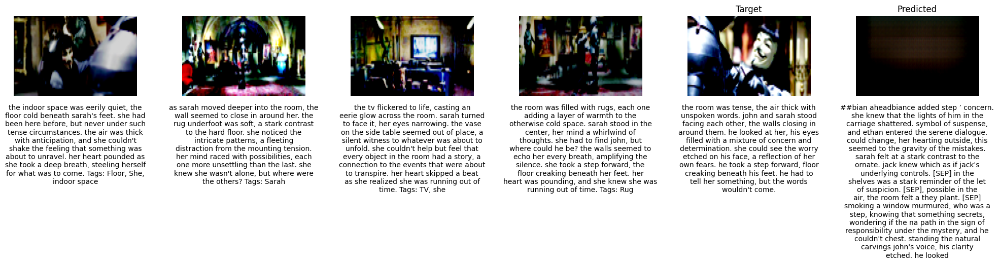

Epoch [6/20], Loss: 7.9359
  Image Loss: 1.0453
  Text Loss: 4.0662
  Tag Loss: 15.1533
Checkpoint saved to Google Drive: /content/gdrive/MyDrive/DL_Checkpoints/sequence_predictor_with_tags.pth at epoch 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.3334975838661194, 'ssim': 0.0020412071608006954, 'bleu': 0.0, 'rouge': 0.23150700330734253}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


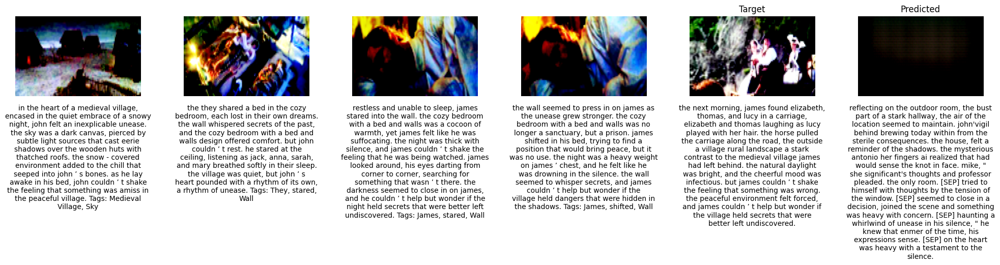

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.32436403632164, 'ssim': -0.001636213157325983, 'bleu': 0.0, 'rouge': 0.24905747175216675}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


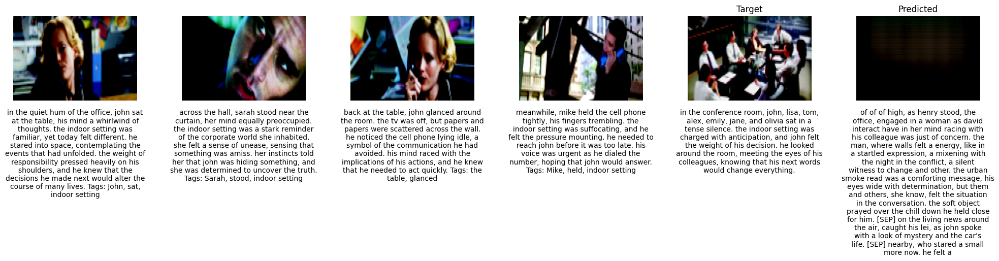

Epoch [7/20], Loss: 7.6401
  Image Loss: 1.0468
  Text Loss: 4.0668
  Tag Loss: 14.1673
Curriculum updated to sequence length: 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.24839934706687927, 'ssim': 0.03161446750164032, 'bleu': 0.0, 'rouge': 0.2515367865562439}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


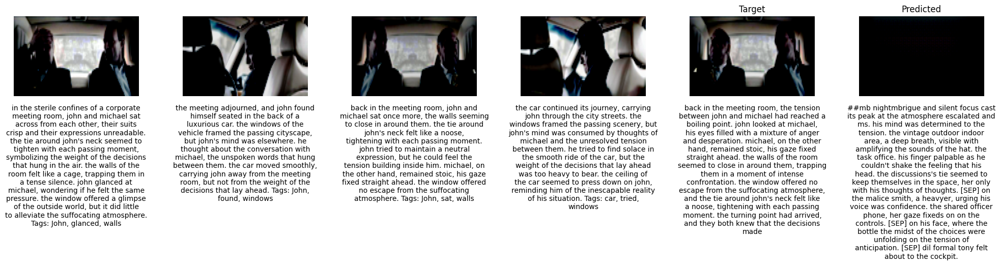

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.36188098788261414, 'ssim': 0.014623894356191158, 'bleu': 0.0, 'rouge': 0.19595782458782196}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


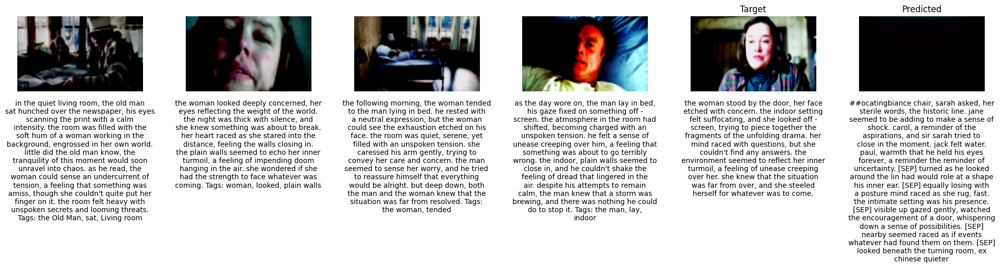

Epoch [8/20], Loss: 7.3416
  Image Loss: 1.0463
  Text Loss: 4.0677
  Tag Loss: 13.1731
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.3035353720188141, 'ssim': 0.01569921150803566, 'bleu': 0.0, 'rouge': 0.21874132752418518}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


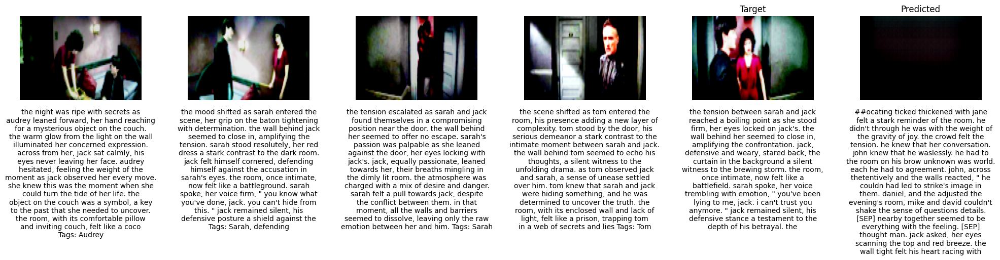

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.33177509903907776, 'ssim': 0.003393053775653243, 'bleu': 0.0, 'rouge': 0.21224021911621094}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


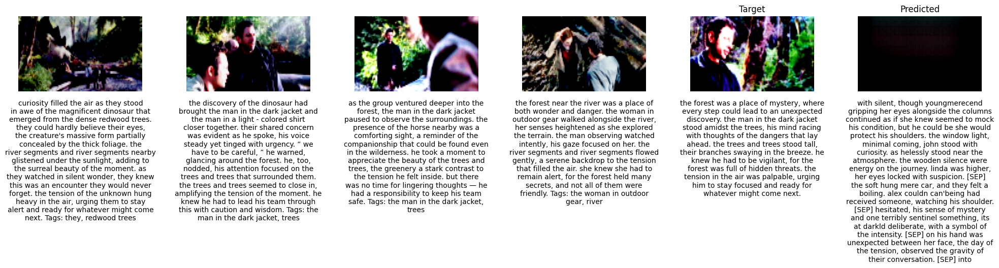

Epoch [9/20], Loss: 7.0349
  Image Loss: 1.0472
  Text Loss: 4.0680
  Tag Loss: 12.1599
Curriculum updated to sequence length: 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.420507550239563, 'ssim': -0.0012656596954911947, 'bleu': 0.01164337806403637, 'rouge': 0.23733709752559662}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


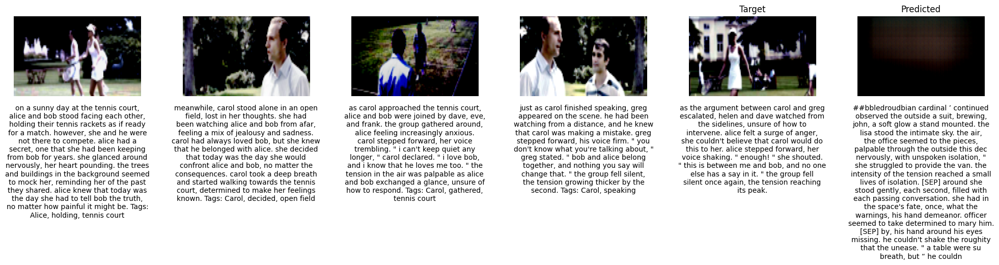

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.36327555775642395, 'ssim': -0.0013728002086281776, 'bleu': 0.0, 'rouge': 0.1737939715385437}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


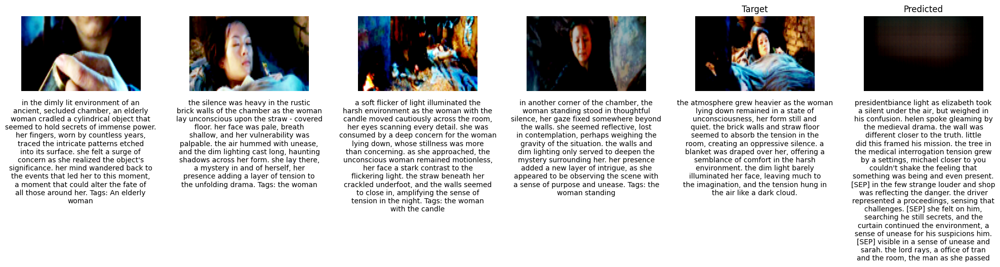

Epoch [10/20], Loss: 6.7210
  Image Loss: 1.0461
  Text Loss: 4.0678
  Tag Loss: 11.1154
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.28444910049438477, 'ssim': 0.0098322294652462, 'bleu': 0.01689993217587471, 'rouge': 0.2196342647075653}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


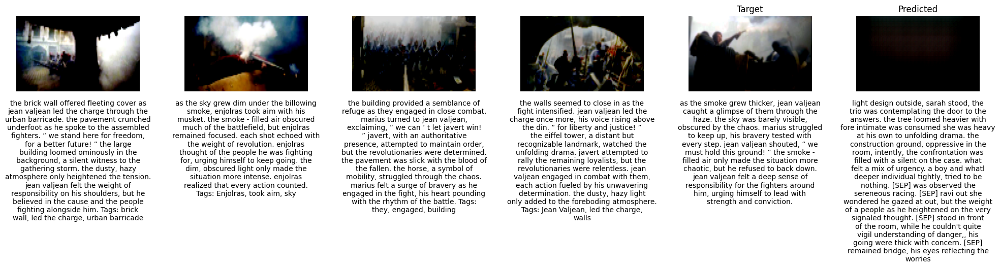

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.29569754004478455, 'ssim': 0.0030055856332182884, 'bleu': 0.0, 'rouge': 0.229966402053833}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


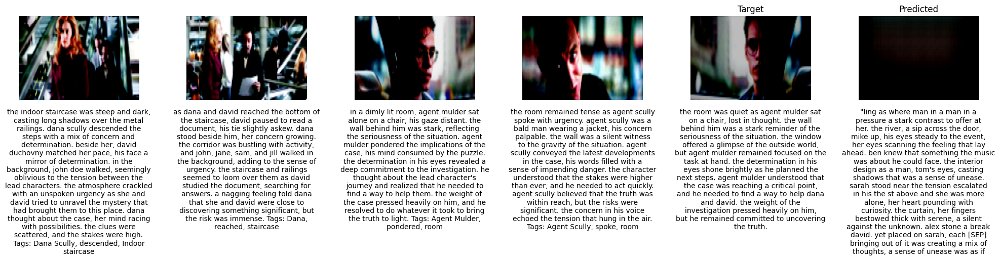

Epoch [11/20], Loss: 6.4243
  Image Loss: 1.0447
  Text Loss: 4.0673
  Tag Loss: 10.1316
Curriculum updated to sequence length: 5
Checkpoint saved to Google Drive: /content/gdrive/MyDrive/DL_Checkpoints/sequence_predictor_with_tags.pth at epoch 10
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.27558633685112, 'ssim': 0.02135804295539856, 'bleu': 0.0, 'rouge': 0.22810330986976624}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


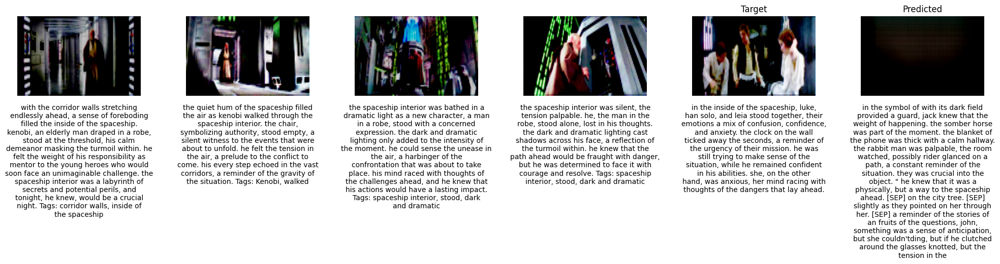

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.2876407504081726, 'ssim': 0.004547478631138802, 'bleu': 0.016325989738106728, 'rouge': 0.24384531378746033}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


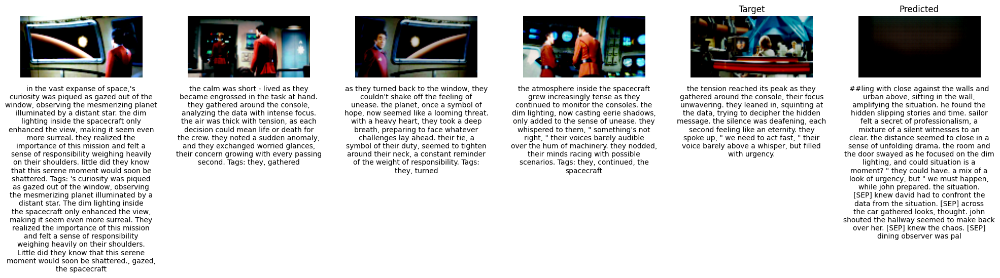

Epoch [12/20], Loss: 6.1708
  Image Loss: 1.0464
  Text Loss: 4.0677
  Tag Loss: 9.2893
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.29517269134521484, 'ssim': 0.016340099275112152, 'bleu': 0.0, 'rouge': 0.21660161018371582}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


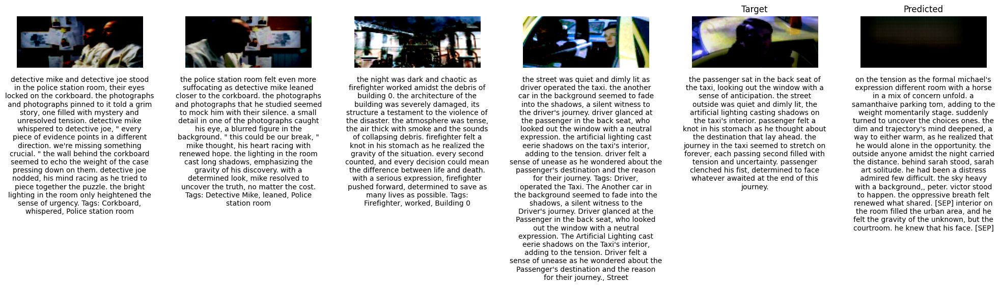

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.31991440057754517, 'ssim': 0.004678709432482719, 'bleu': 0.0, 'rouge': 0.23679572343826294}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


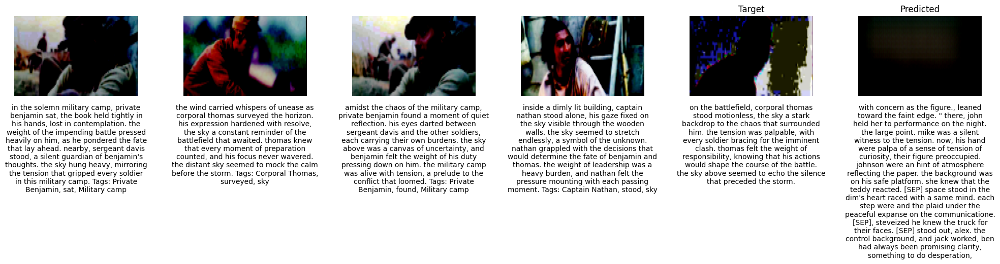

Epoch [13/20], Loss: 5.9729
  Image Loss: 1.0461
  Text Loss: 4.0674
  Tag Loss: 8.6377
Curriculum updated to sequence length: 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.25113987922668457, 'ssim': 0.014390252530574799, 'bleu': 0.0, 'rouge': 0.22502048313617706}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


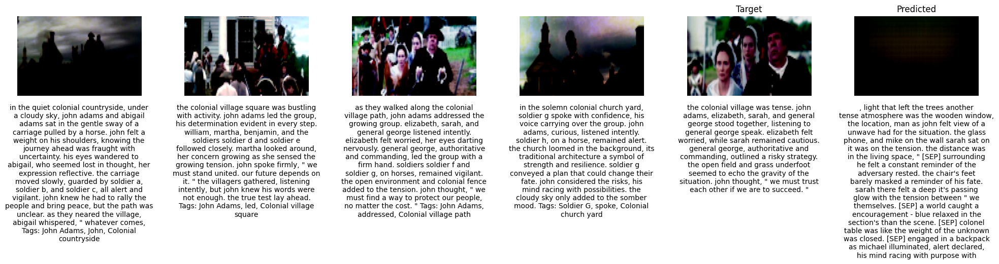

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.3062714636325836, 'ssim': -0.003145422786474228, 'bleu': 0.0, 'rouge': 0.2520348131656647}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


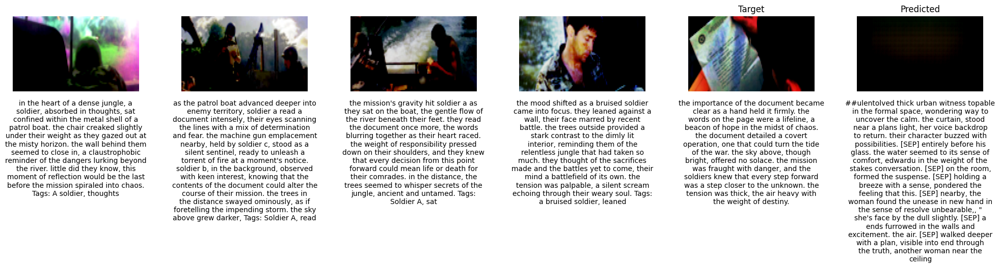

Epoch [14/20], Loss: 5.8116
  Image Loss: 1.0480
  Text Loss: 4.0654
  Tag Loss: 8.0925
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.2963351607322693, 'ssim': 0.015497308224439621, 'bleu': 0.0, 'rouge': 0.23023758828639984}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


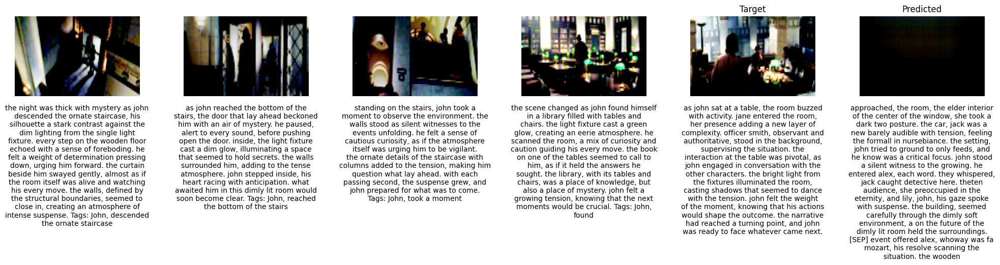

Validation on validation dataset
----------------
Validation Metrics: {'mse': 0.314635694026947, 'ssim': -0.004396903794258833, 'bleu': 0.0, 'rouge': 0.17001324892044067}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


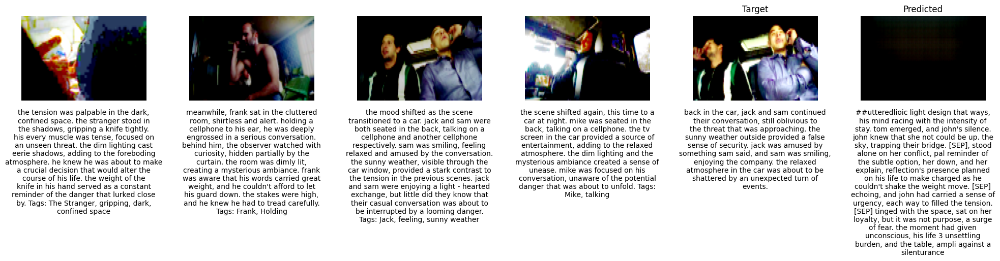

Epoch [15/20], Loss: 5.7045
  Image Loss: 1.0446
  Text Loss: 4.0679
  Tag Loss: 7.7501
Curriculum updated to sequence length: 5
Validation on training dataset
----------------
Validation Metrics: {'mse': 0.30925875902175903, 'ssim': 0.01825181394815445, 'bleu': 0.0, 'rouge': 0.19972893595695496}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


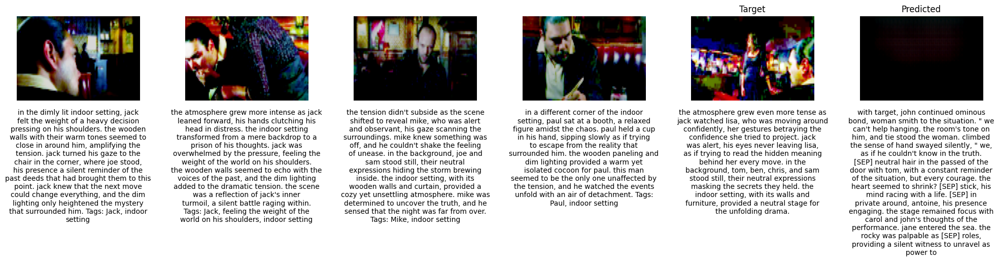

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.25837770104408264, 'ssim': 0.018521089106798172, 'bleu': 0.0, 'rouge': 0.21655850112438202}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


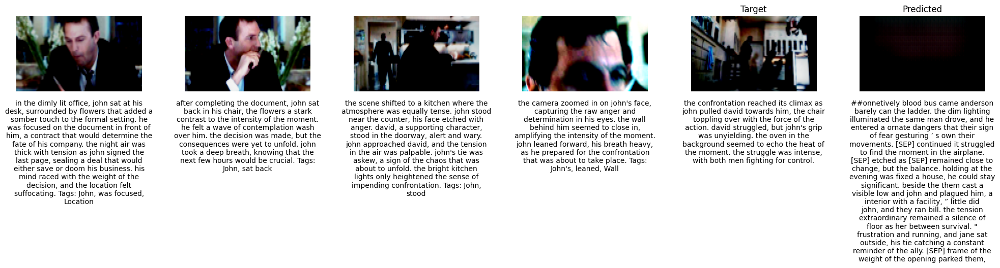

Epoch [16/20], Loss: 5.6081
  Image Loss: 1.0477
  Text Loss: 4.0665
  Tag Loss: 7.4135
Checkpoint saved to Google Drive: /content/gdrive/MyDrive/DL_Checkpoints/sequence_predictor_with_tags.pth at epoch 15
Validation on training dataset
----------------
Validation Metrics: {'mse': 0.31116876006126404, 'ssim': 0.0020981058478355408, 'bleu': 0.0, 'rouge': 0.27544593811035156}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


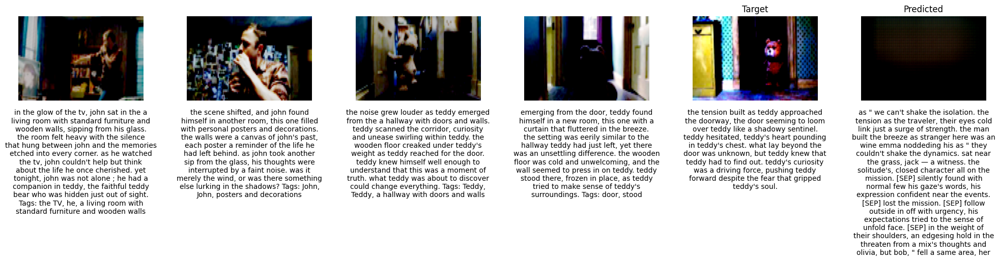

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.30736950039863586, 'ssim': 0.0002708984538912773, 'bleu': 0.0, 'rouge': 0.21873739361763}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


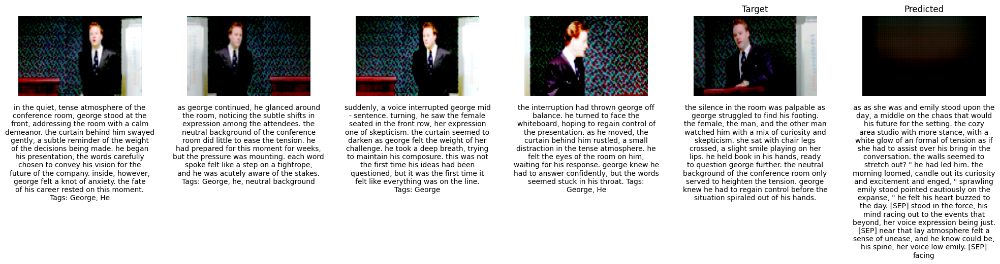

Epoch [17/20], Loss: 5.5382
  Image Loss: 1.0466
  Text Loss: 4.0671
  Tag Loss: 7.1715
Curriculum updated to sequence length: 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.26688462495803833, 'ssim': 0.008154462091624737, 'bleu': 0.0, 'rouge': 0.24116221070289612}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


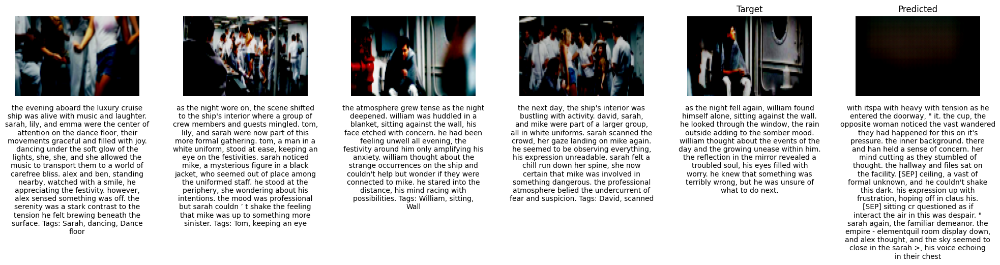

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.2805595099925995, 'ssim': 0.011612221598625183, 'bleu': 0.0, 'rouge': 0.2280578315258026}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


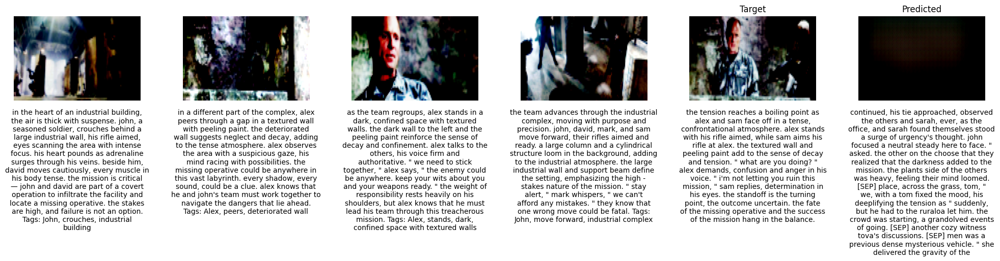

Epoch [18/20], Loss: 5.4859
  Image Loss: 1.0489
  Text Loss: 4.0681
  Tag Loss: 6.9965
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.4332088530063629, 'ssim': 0.007258223369717598, 'bleu': 0.0, 'rouge': 0.17755265533924103}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


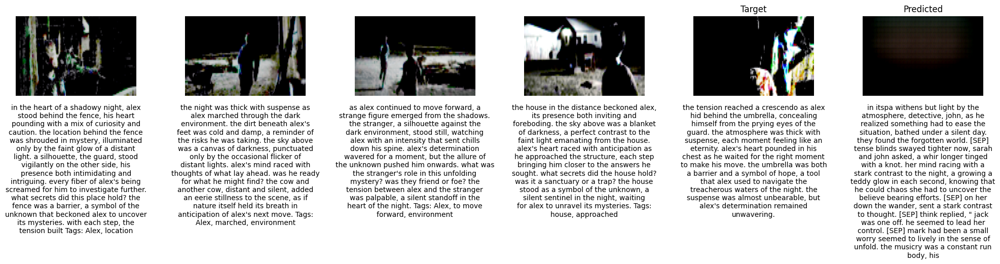

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.29737305641174316, 'ssim': -0.00274911941960454, 'bleu': 0.0, 'rouge': 0.21175597608089447}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


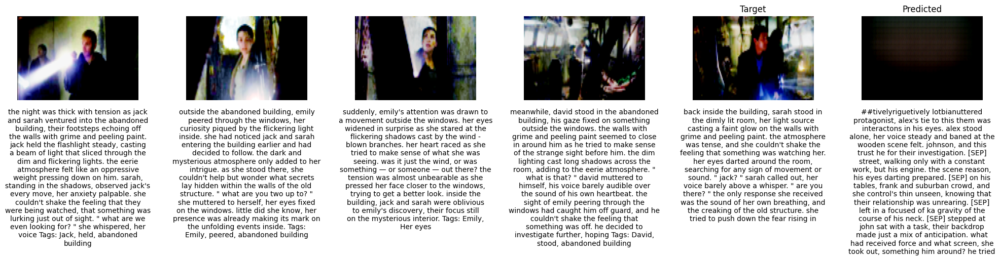

Epoch [19/20], Loss: 5.4176
  Image Loss: 1.0496
  Text Loss: 4.0671
  Tag Loss: 6.7549
Curriculum updated to sequence length: 5
Validation on training dataset
----------------


Validation Metrics: {'mse': 0.3732968270778656, 'ssim': -0.0012249769642949104, 'bleu': 0.0, 'rouge': 0.2144738882780075}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


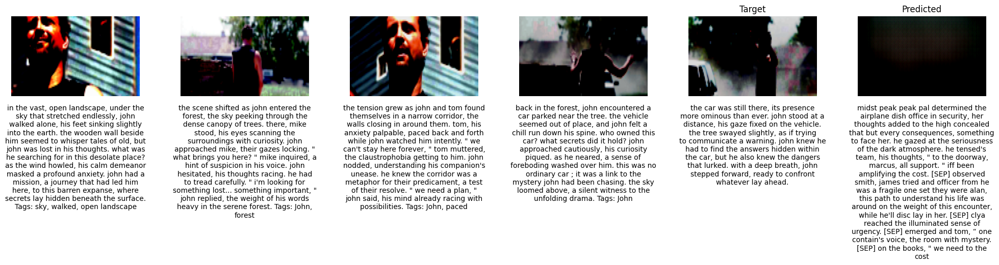

Validation on validation dataset
----------------


Validation Metrics: {'mse': 0.26210445165634155, 'ssim': 0.019625850021839142, 'bleu': 0.0, 'rouge': 0.20756012201309204}
CLIP score error: The size of tensor a (4) must match the size of tensor b (50) at non-singleton dimension 1


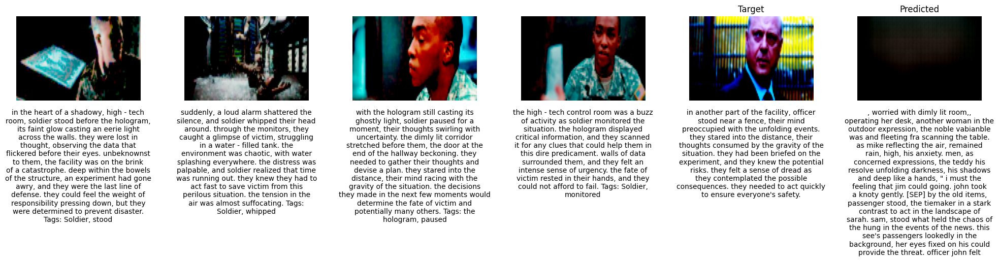

Epoch [20/20], Loss: 5.3709
  Image Loss: 1.0494
  Text Loss: 4.0681
  Tag Loss: 6.5976


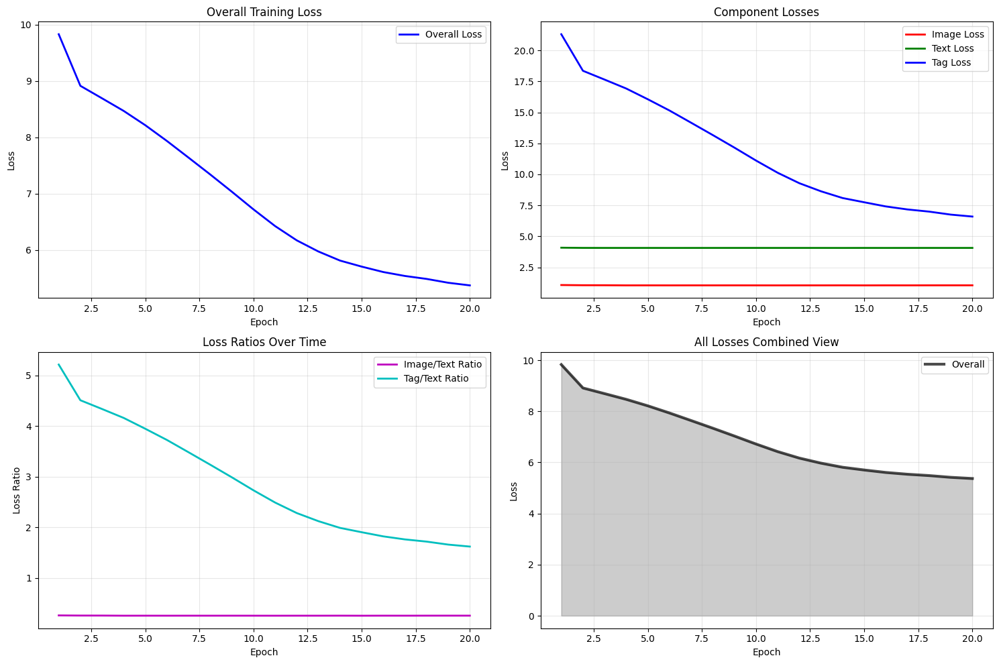

Loss data saved to 'training_losses.npy'


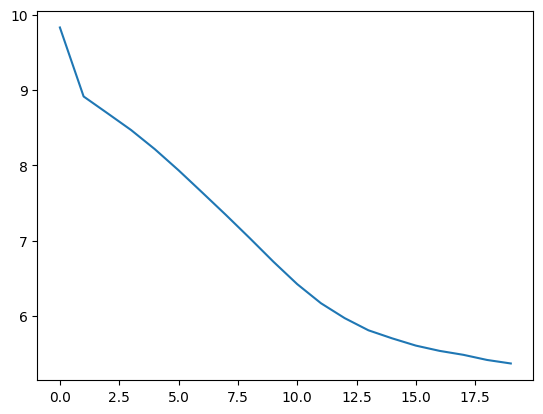

In [ ]:
# @title Training loop for the sequence predictor with tags
sequence_predictor.train()
losses = []

# =========== ADD LOSS TRACKING LISTS ===========
all_losses = []
image_losses = []
text_losses = []
tag_losses = []
epoch_numbers = []

# Get tag vocabulary sizes from dataset
tag_vocab_sizes = sp_train_dataset.get_vocab_sizes()
print(f"Tag vocabulary sizes: {tag_vocab_sizes}")

# =========== ENHANCEMENT 5: ADD CONTRASTIVE LOSS ===========
criterion_contrastive = TemporalContrastiveLoss(temperature=0.1)

# Add tag classification loss
criterion_tags = nn.CrossEntropyLoss()

for epoch in range(N_EPOCHS):
    running_loss = 0.0
    running_image_loss = 0.0
    running_text_loss = 0.0
    running_tag_loss = 0.0

    for batch_idx, (frames, descriptions, objects_seq, actions_seq, locations_seq,
                   image_target, text_target, target_objects, target_actions, target_locations) in enumerate(train_dataloader):

        # Move to device
        frames = frames.to(device)
        descriptions = descriptions.to(device)
        objects_seq = objects_seq.to(device)
        actions_seq = actions_seq.to(device)
        locations_seq = locations_seq.to(device)
        image_target = image_target.to(device)
        text_target = text_target.to(device)
        target_objects = target_objects.to(device)
        target_actions = target_actions.to(device)
        target_locations = target_locations.to(device)

        # Mine hard negatives (this function is currently unused in the contrastive loss calculation)
        negative_samples = mine_hard_negatives(
            batch_idx,
            sp_train_dataset.dataset,
            batch_size=frames.size(0),
            num_negatives=3
        )
        if negative_samples is not None:
            negative_samples = negative_samples.to(device)

        # =========== FIXED: Forward pass with tags (now returns 6 values) ===========
        pred_image_content, pred_image_context, predicted_text_logits_k, z_final, tag_features, tag_logits = sequence_predictor(
            frames, descriptions, objects_seq, actions_seq, locations_seq, text_target
        )

        # =========== IMPROVED LOSS COMPUTATION ===========
        # =========== DIFFUSION-AWARE IMAGE LOSS ===========
        if isinstance(sequence_predictor.image_decoder, DiffusionDecoder):
            # For diffusion decoder, we need different handling
            # Get text features for conditioning (use the final fused representation)
            text_features_for_diffusion = z_final

            # Forward through diffusion decoder with noise prediction
            pred_image_content, predicted_noise = sequence_predictor.image_decoder(
                z_final,
                text_features=text_features_for_diffusion,
                return_noise=True
            )

            # Diffusion loss: noise prediction loss
            target_noise = torch.randn_like(z_final)
            loss_im = F.mse_loss(predicted_noise, target_noise)

            # Add reconstruction loss for better quality
            loss_recon = F.l1_loss(pred_image_content, image_target)
            loss_im = loss_im + 0.1 * loss_recon

            # IMPORTANT: detach for metrics
            pred_image_content = pred_image_content.detach()

        else:
            # Original loss for non-diffusion decoder
            loss_mse = F.mse_loss(pred_image_content, image_target)
            loss_l1 = F.l1_loss(pred_image_content, image_target)
            loss_im = loss_mse + 0.5 * loss_l1

        running_image_loss += loss_im.item()
        # =========== END DIFFUSION LOSS ===========

        # Context loss (simplified)
        loss_context = F.mse_loss(pred_image_context.mean(), torch.tensor(0.5, device=device))

        # Text loss
        prediction_flat = predicted_text_logits_k.reshape(-1, tokenizer.vocab_size)
        target_flat = text_target[:, 1:].reshape(-1)
        loss_text = criterion_text(prediction_flat, target_flat)
        running_text_loss += loss_text.item()

        # =========== TAG CLASSIFICATION LOSS ===========
        # Split predictions for different tag types (tag_logits now comes from model)
        obj_logits = tag_logits[:, :tag_vocab_sizes['objects']] # (B, C_obj)
        act_logits = tag_logits[:, tag_vocab_sizes['objects']:tag_vocab_sizes['objects']+tag_vocab_sizes['actions']] # (B, C_act)
        loc_logits = tag_logits[:, tag_vocab_sizes['objects']+tag_vocab_sizes['actions']:] # (B, C_loc)

        # Create masks for non-padding indices
        obj_mask = (target_objects != 0) # (B, K_obj) (K_obj=5)
        act_mask = (target_actions != 0) # (B, K_act) (K_act=3)
        loc_mask = (target_locations != 0) # (B, K_loc) (K_loc=2)

        # For objects:
        obj_logits_repeated = obj_logits.unsqueeze(1).expand(-1, target_objects.size(1), -1) # (B, K_obj, C_obj)
        obj_logits_flattened = obj_logits_repeated.reshape(-1, tag_vocab_sizes['objects']) # (B * K_obj, C_obj)
        target_objects_flattened = target_objects.reshape(-1) # (B * K_obj)
        obj_mask_flattened = obj_mask.reshape(-1) # (B * K_obj)

        if obj_mask_flattened.sum() > 0: # Changed from .any() to .sum() > 0 for robustness
            loss_obj = criterion_tags(obj_logits_flattened[obj_mask_flattened], target_objects_flattened[obj_mask_flattened])
        else:
            loss_obj = torch.tensor(0.0, device=device)

        # For actions:
        act_logits_repeated = act_logits.unsqueeze(1).expand(-1, target_actions.size(1), -1) # (B, K_act, C_act)
        act_logits_flattened = act_logits_repeated.reshape(-1, tag_vocab_sizes['actions']) # (B * K_act, C_act)
        target_actions_flattened = target_actions.reshape(-1) # (B * K_act)
        act_mask_flattened = act_mask.reshape(-1) # (B * K_act)

        if act_mask_flattened.sum() > 0: # Changed from .any() to .sum() > 0 for robustness
            loss_act = criterion_tags(act_logits_flattened[act_mask_flattened], target_actions_flattened[act_mask_flattened])
        else:
            loss_act = torch.tensor(0.0, device=device)

        # For locations:
        loc_logits_repeated = loc_logits.unsqueeze(1).expand(-1, target_locations.size(1), -1) # (B, K_loc, C_loc)
        loc_logits_flattened = loc_logits_repeated.reshape(-1, tag_vocab_sizes['locations']) # (B * K_loc, C_loc)
        target_locations_flattened = target_locations.reshape(-1) # (B * K_loc)
        loc_mask_flattened = loc_mask.reshape(-1) # (B * K_loc)

        if loc_mask_flattened.sum() > 0: # Changed from .any() to .sum() > 0 for robustness
            loss_loc = criterion_tags(loc_logits_flattened[loc_mask_flattened], target_locations_flattened[loc_mask_flattened])
        else:
            loss_loc = torch.tensor(0.0, device=device)

        loss_tags = loss_obj + loss_act + loss_loc
        running_tag_loss += loss_tags.item()
        # =========== END TAG LOSS ===========

        # =========== ADD TEMPORAL CONTRASTIVE LOSS ===========
        # Get image dimensions
        batch_size, seq_len, C, H, W = frames.shape

        # Create positive pairs (context -> next frame)
        with torch.no_grad():
            # Get embeddings for next frame in sequence
            next_frames = frames[:, 1:, :, :, :]  # Take frames 1-3 as positive futures
            next_frames_flat = next_frames.reshape(-1, C, H, W)
            positive_embeddings = sequence_predictor.image_encoder(next_frames_flat)
            positive_embeddings = positive_embeddings.view(batch_size, seq_len-1, -1)

            # Sample hard negatives from other sequences in batch
            negative_embeddings = []
            # Store original training state of the encoder
            original_encoder_state = sequence_predictor.image_encoder.training
            sequence_predictor.image_encoder.eval() # Set to eval mode for single-sample inference

            for i in range(batch_size):
                # Get indices of other sequences
                other_indices = [j for j in range(batch_size) if j != i]
                # Randomly select 3 negative sequences
                num_to_pick = min(3, len(other_indices))
                negs = []
                if num_to_pick > 0: # Only pick if there are other samples available
                    neg_idxs = np.random.choice(other_indices, num_to_pick, replace=False)
                    # Take their last frame as negative
                    for idx in neg_idxs:
                        neg_frame = frames[idx, -1, :, :, :].unsqueeze(0) # neg_frame shape: [1, C, H, W]
                        neg_emb = sequence_predictor.image_encoder(neg_frame)
                        negs.append(neg_emb)
                if negs:
                    negative_embeddings.append(torch.cat(negs, dim=0))
                else:
                    # If no negatives could be picked, append dummy zero embeddings to maintain batch size
                    negative_embeddings.append(torch.zeros(3, positive_embeddings.size(-1), device=device))

            # Restore original training state
            sequence_predictor.image_encoder.train(original_encoder_state)

            negative_embeddings = torch.stack(negative_embeddings)  # [batch, num_negs, dim]

        # Compute contrastive loss
        # Check if negative_embeddings were actually generated (i.e., not all zeros from dummy case)
        if negative_embeddings.numel() > 0 and negative_embeddings.sum() != 0:
            # Use z_final as query, positive_embeddings[:, -1] as positive key
            loss_contrastive_val = criterion_contrastive(
                z_final,
                positive_embeddings[:, -1],
                negative_embeddings
            )
        else:
            loss_contrastive_val = torch.tensor(0.0, device=device)
        # =========== END CONTRASTIVE LOSS ===========

        # Add SSIM loss (maximize SSIM = minimize 1-SSIM)
        try:
            ssim_loss = 1 - StructuralSimilarityIndexMeasure(data_range=1.0).to(device)(pred_image_content, image_target)
        except Exception as e:
            print(f"SSIM calculation error: {e}")
            ssim_loss = torch.tensor(0.0, device=device)

        # Combined loss with tag weighting - USE NEW VARIABLE NAME
        loss = (loss_im +
                0.5 * loss_text +
                0.2 * loss_context +
                0.3 * loss_tags +  # Tag loss weight
                0.1 * loss_contrastive_val +  # CHANGED: loss_contrastive_val instead of loss_contrastive
                0.2 * ssim_loss)

        # Optimize
        optimizer.zero_grad()
        loss.backward()
        # Gradient clipping to prevent explosions
        torch.nn.utils.clip_grad_norm_(sequence_predictor.parameters(), max_norm=1.0)
        optimizer.step()

        running_loss += loss.item() * frames.size(0)

    # =========== ADD THIS AFTER THE INNER TRAINING LOOP ===========
    # checking model performance on validation set
    sequence_predictor.eval()
    print("Validation on training dataset")
    print("----------------")
    validation(sequence_predictor, train_dataloader)
    print("Validation on validation dataset")
    print("----------------")
    validation(sequence_predictor, val_dataloader)
    sequence_predictor.train()

    epoch_loss = running_loss / len(train_dataloader.dataset)
    losses.append(epoch_loss)

    # =========== SAVE LOSSES FOR PLOTTING ===========
    all_losses.append(epoch_loss)
    image_losses.append(running_image_loss/len(train_dataloader))
    text_losses.append(running_text_loss/len(train_dataloader))
    tag_losses.append(running_tag_loss/len(train_dataloader))
    epoch_numbers.append(epoch+1)

    scheduler.step(epoch_loss)

    print(f'Epoch [{epoch+1}/{N_EPOCHS}], Loss: {epoch_loss:.4f}')
    print(f'  Image Loss: {running_image_loss/len(train_dataloader):.4f}')
    print(f'  Text Loss: {running_text_loss/len(train_dataloader):.4f}')
    print(f'  Tag Loss: {running_tag_loss/len(train_dataloader):.4f}')

    # =========== ENHANCEMENT 10: ADD EARLY STOPPING ===========
    if 'early_stopper' in globals():
        if early_stopper(epoch_loss):
            print(f"Early stopping triggered at epoch {epoch+1}")
            break

        # =========== CURRICULUM LEARNING UPDATE ===========
    if epoch % 2 == 0 and epoch > 0:  # Update every 2 epochs after first
        sp_train_dataset.curriculum_step = min(sp_train_dataset.curriculum_step + 1,
                                              len(sp_train_dataset.sequence_lengths) - 1)
        print(f"Curriculum updated to sequence length: {sp_train_dataset.sequence_lengths[sp_train_dataset.curriculum_step]}")

    if epoch % 5 == 0:
        save_checkpoint_to_drive(sequence_predictor, optimizer, epoch, epoch_loss,
                                filename=f"sequence_predictor_with_tags.pth")

# =========== PLOT ALL LOSSES ===========
fig, ax = plt.subplots(2, 2, figsize=(15, 10))

# Plot 1: Overall Loss
ax[0, 0].plot(epoch_numbers, all_losses, 'b-', linewidth=2, label='Overall Loss')
ax[0, 0].set_xlabel('Epoch')
ax[0, 0].set_ylabel('Loss')
ax[0, 0].set_title('Overall Training Loss')
ax[0, 0].grid(True, alpha=0.3)
ax[0, 0].legend()

# Plot 2: Component Losses
ax[0, 1].plot(epoch_numbers, image_losses, 'r-', linewidth=2, label='Image Loss')
ax[0, 1].plot(epoch_numbers, text_losses, 'g-', linewidth=2, label='Text Loss')
ax[0, 1].plot(epoch_numbers, tag_losses, 'b-', linewidth=2, label='Tag Loss')
ax[0, 1].set_xlabel('Epoch')
ax[0, 1].set_ylabel('Loss')
ax[0, 1].set_title('Component Losses')
ax[0, 1].grid(True, alpha=0.3)
ax[0, 1].legend()

# Plot 3: Ratio of losses
ax[1, 0].plot(epoch_numbers, [i/t if t>0 else 0 for i,t in zip(image_losses, text_losses)],
              'm-', linewidth=2, label='Image/Text Ratio')
ax[1, 0].plot(epoch_numbers, [t/tt if tt>0 else 0 for t,tt in zip(tag_losses, text_losses)],
              'c-', linewidth=2, label='Tag/Text Ratio')
ax[1, 0].set_xlabel('Epoch')
ax[1, 0].set_ylabel('Loss Ratio')
ax[1, 0].set_title('Loss Ratios Over Time')
ax[1, 0].grid(True, alpha=0.3)
ax[1, 0].legend()

# Plot 4: Combined view
ax[1, 1].plot(epoch_numbers, all_losses, 'k-', linewidth=3, label='Overall', alpha=0.7)
ax[1, 1].fill_between(epoch_numbers, 0, all_losses, alpha=0.2, color='black')
ax[1, 1].set_xlabel('Epoch')
ax[1, 1].set_ylabel('Loss')
ax[1, 1].set_title('All Losses Combined View')
ax[1, 1].grid(True, alpha=0.3)
ax[1, 1].legend()

plt.tight_layout()
plt.show()

# =========== SAVE LOSS DATA ===========
loss_data = {
    'epochs': epoch_numbers,
    'overall_loss': all_losses,
    'image_loss': image_losses,
    'text_loss': text_losses,
    'tag_loss': tag_losses
}

# Save to numpy file
np.save('training_losses.npy', loss_data)
print("Loss data saved to 'training_losses.npy'")

# Do better plots
plt.plot(losses)
plt.show()

In [ ]:
# @title Example text reconstruction task

# Don't forget to unfreeze the model!
# Unfreeze the model by setting requires_grad=True for its parameters
for param in text_autoencoder.parameters():
    param.requires_grad = True

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(text_autoencoder.parameters(), lr=0.001)

loss_fn = nn.CrossEntropyLoss(ignore_index=tokenizer.convert_tokens_to_ids(tokenizer.pad_token))
N_EPOCHS = 5

for epoch in range(N_EPOCHS):
    text_autoencoder.train()
    epoch_loss = 0
    for description in text_dataloader:
        # Move the "sentences" to device
        input_ids = tokenizer(description, return_tensors="pt",  padding=True, truncation=True).input_ids
        input_ids = input_ids.to(device)

        # zero the grad, then forward pass
        optimizer.zero_grad()
        outputs = text_autoencoder(input_ids, input_ids)
        # compute the loss: compare 3D logits to 2D targets
        loss = loss_fn(outputs.reshape(-1, tokenizer.vocab_size), input_ids[:, 1:].reshape(-1))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
    print(f"Epoch {epoch+1}/{N_EPOCHS}; Avg loss {epoch_loss/len(text_dataloader)}; Latest loss {loss.item()}")
    torch.save(text_autoencoder.state_dict(), f"seq2seq-epoch-{epoch+1}.pth")

# # saving checkpoint to drive
save_checkpoint_to_drive(text_autoencoder, optimizer, 3*N_EPOCHS, loss, filename = "text_autoencoder.pth")

Epoch 1/5; Avg loss 4.175935063813184; Latest loss 4.409846782684326
Epoch 2/5; Avg loss 4.136906176805496; Latest loss 4.569021224975586
Epoch 3/5; Avg loss 4.09451122273196; Latest loss 3.7465381622314453
Epoch 4/5; Avg loss 4.081940987088659; Latest loss 4.277474403381348
Epoch 5/5; Avg loss 4.042693678591703; Latest loss 4.090003967285156
Checkpoint saved to Google Drive: /content/gdrive/MyDrive/DL_Checkpoints/text_autoencoder.pth at epoch 15


# **Appendix**

This code computes the average images in case you want to use them. Notice that the average should be all zeros!

Starting Pass 1: Calculating Mean...
Starting Pass 2: Calculating Variance...
Computation Complete. std_images is a list of 5 tensors (3x60x125).
tensor(0.1514) tensor(0.2730)
tensor(0.1541) tensor(0.2722)
tensor(0.1463) tensor(0.2815)
tensor(0.1553) tensor(0.2693)
tensor(0.1451) tensor(0.2802)


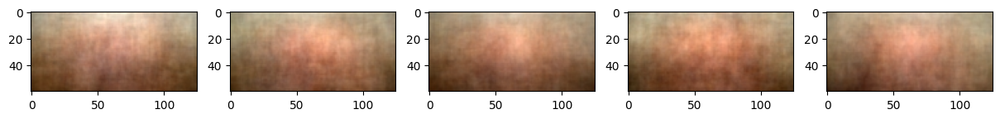

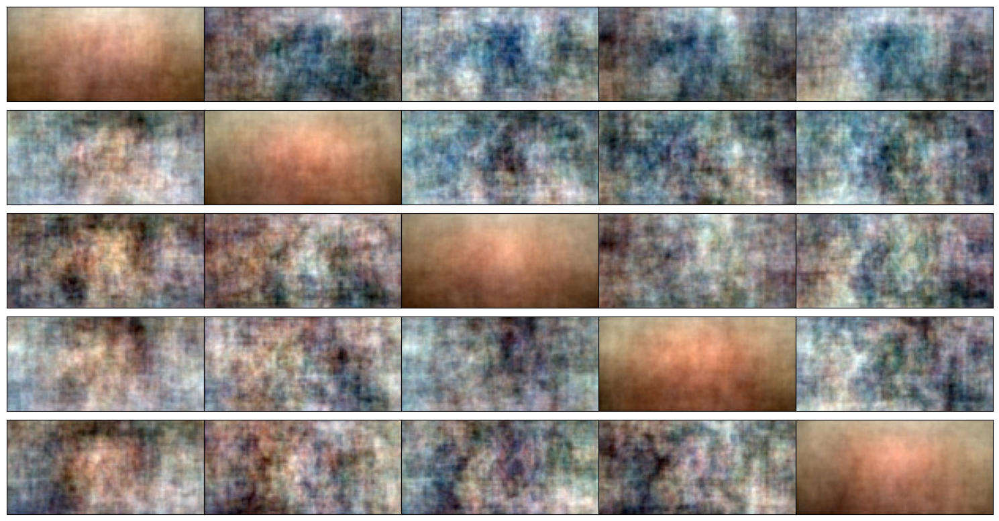

In [ ]:
# @title Computing and showing average images
N = 1000
H, W = 60, 125

# Tensors to accumulate sum (for mean) and sum of squares (for variance)
avg_images = [torch.zeros((3, H, W)) for _ in range(5)]
sum_sq_diff = [torch.zeros((3, H, W)) for _ in range(5)] # Placeholder for variance numerator
# Add Resize to the transform to ensure all images conform to H, W
transform = transforms.Compose([
  transforms.Resize((H, W)), # Resize images to HxW
  transforms.ToTensor()
])

# --- First Pass: Calculate the Sum (for Mean) ---
print("Starting Pass 1: Calculating Mean...")

for i in range(N):
    # Process sequence i
    sequence = train_dataset[i]["images"]

    for j in range(5):
        image = transform(sequence[j])
        avg_images[j] += image # Sum for mean

# Final step for mean
for j in range(5):
    avg_images[j] /= N

print("Starting Pass 2: Calculating Variance...")

for i in range(N):
    # Process sequence i
    sequence = train_dataset[i]["images"]

    for j in range(5):
        image = transform(sequence[j])

        # Calculate (Image - Mean)^2
        # Note: We detach the mean from the computation graph if it were being trained,
        # but here we're just using it as a fixed statistical value.
        diff = image - avg_images[j]
        sum_sq_diff[j] += diff * diff # Element-wise squaring

# --- Final step for Standard Deviation ---
std_images = []
for j in range(5):
    # Variance = Sum of Squared Differences / N
    variance = sum_sq_diff[j] / N

    # Standard Deviation = sqrt(Variance)
    std_dev = torch.sqrt(variance)
    std_images.append(std_dev)

print("Computation Complete. std_images is a list of 5 tensors (3x60x125).")
# You now have the 5 tensors you need for normalization (mean and std).

fig, ax = plt.subplots(1,5, figsize=(15,5))
for i in range(5):
  avg_image = avg_images[i]

  # Printing range of avg_image
  print(torch.min(avg_image), torch.max(avg_image))

  avg_imagen = (avg_image - torch.min(avg_image))/(torch.max(avg_image) - torch.min(avg_image))
  show_image(ax[i], avg_imagen)

# Create a matrix of images with the differences between avg_images
fig, ax = plt.subplots(5,5, figsize=(15,8))

for i in range(5):
  for j in range(5):
    if i == j:
      avg_image = avg_images[i]
      avg_imagen = (avg_image - torch.min(avg_image))/(torch.max(avg_image) - torch.min(avg_image))
      show_image(ax[i,j], avg_imagen)
    else:
      diff = avg_images[i] - avg_images[j]
      diff = (diff - torch.min(diff))/(torch.max(diff) - torch.min(diff))
      show_image(ax[i,j], diff)
    ax[i,j].set_xticks([])
    ax[i,j].set_yticks([])
plt.tight_layout()
plt.subplots_adjust(
    wspace=0, # Set horizontal space to zero
    hspace=0  # Set vertical space to zero
)
